<a href="https://colab.research.google.com/github/Lucile-S/ART_project/blob/main/WCGAN_Painting_by_ARTIST_V2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## packages

In [ ]:
!pip install tensorboard
!pip install "tqdm==4.43.0"
import os
from time import sleep
from tqdm import tqdm
from glob import iglob
import pandas as pd
import pandas as pd

from collections import Counter
import itertools

import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.datasets as datasets
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torch.utils.tensorboard import SummaryWriter
import matplotlib.pyplot as plt
import numpy as np
from torchvision.utils import make_grid
from torch.utils.data import Dataset
from torchvision.utils import save_image
from torch.utils.data import random_split
import torchvision.transforms as transforms
from torchvision.datasets.folder import default_loader
from torchvision.utils import save_image
import torch.nn.functional as F
from scipy import linalg
from PIL import Image
import cv2
import copy
import urllib
import time
from datetime import datetime
import collections 

%matplotlib inline

     |████████████████████████████████| 59 kB 6.3 MB/s 
  Attempting uninstall: tqdm
    Found existing installation: tqdm 4.62.3
    Uninstalling tqdm-4.62.3:
      Successfully uninstalled tqdm-4.62.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
panel 0.12.1 requires tqdm>=4.48.0, but you have tqdm 4.43.0 which is incompatible.


## Classes

In [ ]:
class Artist(object):
    """
    Artist Object
    """
    def __init__(self, folder_path:str, label_id=None ):
        self._path = folder_path.replace('\\',r'/')
        self._label_id = label_id

    @property
    def folder_name(self):
        return os.path.basename(self._path)

    @property
    def name(self):
      return os.path.basename(self._path).replace('-',' ').title()

    @property
    def path(self):
        return self._path
    
    @property
    def painting_paths(self):
        return list(iglob(self._path + '/*.jpg'))

    @property
    def painting_titles(self):
        return [ os.path.basename(painting_path).replace('.jpg','').replace('-',' ').capitalize() for painting_path in iglob(self._path + '/*.jpg') ]

    @property
    def painting_nb(self):
      return len(list(iglob(self._path + '/*.jpg')))

    @property
    def label(self):
        # just one label_id
        if isinstance(self._label_id, int):
            return self._label_id
        # sample associated with multiple labels
        else:
            return [int(label_id) for label_id in self._label_id]
  

class Painting(object):
    """
    Painting Object
    """
    def __init__(self, painting_path:str):
        self._path = painting_path.replace('\\',r'/')
        self._json = self._path.replace('.jpg','.json')
        self._data = open_json_file(self._json)
        self._filename = os.path.basename(self._json).replace('.json','')
        self._key = list(self._data.keys())[0]

    @property
    def data(self):
      return  self._data


    @property
    def filename(self):
      return  self._filename


    @property
    def name(self):
      return  self._data[self._key]['Name']

    @property
    def artist(self):
      return  self._data[self._key]['Artist']


    @property
    def date(self):
      return self._data[self._key]['Date']
  
  
    @property
    def style(self):
      return self._data[self._key]['Style']
    
    @property
    def genre(self):
      return self._data[self._key]['Genre']

        
    @property
    def tags(self):
      return self._data[self._key]['Tags']

class Art_Dataset(Dataset):
    """
    Args:
        image_paths (list): list of image paths.
        df (pandas dataframe) : dataframe containning images names and encoding labels 
        classes (list): list of classes.
        transform (callable, optional): Optional transform to be applied on a sample.
    """
    def __init__(self, image_paths:list, labels:list, transform =None):
      self.image_paths = image_paths
      self.labels = labels 
      self.transform  = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, index):
        #print(f'--- GET ITEM  # {index} ---')
        image_path = self.image_paths[index]
        image = Image.open(image_path).convert('RGB') 
        label =  self.labels[index]
        if self.transform:
            image = self.transform(image)
        return image, label, image_path


class CustomResize(object):
    def __init__(self, size, interpolation=Image.BILINEAR):
        self.size = size
        self.interpolation = interpolation

    def __call__(self, img):
        old_size = img.size  # old_size[0] is in (width, height) format

        ratio = float(self.size)/min(old_size)
        new_size = tuple([int(x * ratio) for x in old_size])

        return img.resize(new_size, resample=self.interpolation)

## utils

In [ ]:
## utils

def MakeDir(DIR:str) -> None:
    try:
        if not os.path.exists(DIR):
            os.makedirs(DIR)
    except OSError as err:
        print(err)
        pass

def show_batch(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    try: 
      image_unflat = image_tensor.detach().cpu()
    except: 
      image_unflat = image_tensor
      
    plt.figure(figsize = (12,12))
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()




def save_checkpoint(state, filename="celeba_wgan_gp.pth.tar"):
    print("=> Saving checkpoint")
    torch.save(state, filename)


def load_checkpoint(checkpoint, gen, disc):
    print("=> Loading checkpoint")
    gen.load_state_dict(checkpoint['gen'])
    disc.load_state_dict(checkpoint['disc'])
    

def show_tensor_images(image_tensor, num_images=25, size=(1,64, 64), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

def save_samples(index, epoch, fixed_noise, fixed_labels,  stats , sample_dir = '.', resize_size=128, show=True):
    fake_images = gen(fixed_noise, fixed_labels)
    fake_fname = f'Wcgan-byartist-v2-generated-images-{index:0=5d}-epoch-{epoch:0=4d}.jpg'
    save_image(denorm(transforms.Resize(resize_size)(fake_images), stats).clamp(0, 1), os.path.join(sample_dir, fake_fname), nrow=8)
    print('Saving', fake_fname)
    if show:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(denorm(fake_images.detach().cpu(), stats), nrow=8).permute(1, 2, 0).squeeze())
        plt.show()


def denorm(img_tensors, stats):
    return img_tensors * stats[1][0] + stats[0][0]


# Gradient Penalty function

In [ ]:
def gradient_penalty(critic, labels, real, fake, device="cpu"):
    BATCH_SIZE, C, H, W = real.shape
    alpha = torch.rand((BATCH_SIZE, 1, 1, 1)).repeat(1, C, H, W).to(device)
    interpolated_images = real * alpha + fake * (1 - alpha)

    # Calculate critic scores
    mixed_scores = critic(interpolated_images, labels)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_images,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

## Models

In [ ]:
"""
Discriminator and Generator implementation from DCGAN paper
"""

class Discriminator(nn.Module):
    def __init__(self, channels_img, features_d, num_classes,  img_size):
        super(Discriminator, self).__init__()
        self.img_size = img_size
        self.channels_img = channels_img
        self.disc = nn.Sequential(
            # input: N x channels_img x 64 x 64
            nn.Conv2d(self.channels_img + num_classes , features_d, kernel_size=4, stride=2, padding=1),
            #nn.Conv2d(self.channels_img +1 , features_d, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            # _block(in_channels, out_channels, kernel_size, stride, padding)
            self._block(features_d, features_d * 2, 4, 2, 1),
            self._block(features_d * 2, features_d * 4, 4, 2, 1),
            self._block(features_d * 4, features_d * 8, 4, 2, 1),
            # After all _block img output is 4x4 (Conv2d below makes into 1x1)
            nn.Conv2d(features_d * 8, 1, kernel_size=4, stride=2, padding=0),
        )
        self.embed = nn.Embedding(num_classes, num_classes)
        #self.embed = nn.Embedding(num_classes, img_size*img_size)


    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.Conv2d(
                in_channels, out_channels, kernel_size, stride, padding, bias=False,
            ),
            nn.InstanceNorm2d(out_channels, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x, labels):
        #embedding =  self.embed(labels).view(labels.shape[0], self.channels_img, self.img_size, self.img_size) # it's like an additional channel ; # N x C x H x W
        embedding =   self.embed(labels)[:,:,None,None].repeat(1, 1, self.img_size, self.img_size) # N x N_classes x IMG_SIZE x IMG_siSE
       
        x = torch.cat([x, embedding], dim=1)

        return self.disc(x)


class Generator(nn.Module):
    def __init__(self, channels_noise, channels_img, features_g, num_classes, img_size, embed_size):
        super(Generator, self).__init__()
        self.img_size = img_size
        self.net = nn.Sequential(
            # Input: N x channels_noise x 1 x 1
            self._block(channels_noise + embed_size, features_g * 16, 4, 1, 0),  # img: 4x4
            self._block(features_g * 16, features_g * 8, 4, 2, 1),  # img: 8x8
            self._block(features_g * 8, features_g * 4, 4, 2, 1),  # img: 16x16
            self._block(features_g * 4, features_g * 2, 4, 2, 1),  # img: 32x32
            nn.ConvTranspose2d(
                features_g * 2, channels_img, kernel_size=4, stride=2, padding=1
            ),
            # Output: N x channels_img x 64 x 64
            nn.Tanh(),
        )
        self.embed = nn.Embedding(num_classes,embed_size)
        #self.embed = nn.Embedding(num_classes,num_classes)

    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.ConvTranspose2d(
                in_channels, out_channels, kernel_size, stride, padding, bias=False,
            ),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(),
        )

    def forward(self, x, labels):
        embedding = self.embed(labels).unsqueeze(2).unsqueeze(3)
        x = torch.cat([x, embedding], dim=1)
        return self.net(x)


def initialize_weights(model):
    # Initializes weights according to the DCGAN paper
    for m in model.modules():
        if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.BatchNorm2d)):
            nn.init.normal_(m.weight.data, 0.0, 0.02)


# Fretchet Inception Distance
FID measures the distance between the Inception-v3 activation distributions for generated and real samples. But before looking into FID let's discuss a little about it's predecessor Inception Score.

https://www.kaggle.com/ibtesama/gan-in-pytorch-with-fid



In [ ]:
import torchvision.models as models
class InceptionV3(nn.Module):
    """Pretrained InceptionV3 network returning feature maps"""

    # Index of default block of inception to return,
    # corresponds to output of final average pooling
    DEFAULT_BLOCK_INDEX = 3

    # Maps feature dimensionality to their output blocks indices
    BLOCK_INDEX_BY_DIM = {
        64: 0,   # First max pooling features
        192: 1,  # Second max pooling featurs
        768: 2,  # Pre-aux classifier features
        2048: 3  # Final average pooling features
    }

    def __init__(self,
                 output_blocks=[DEFAULT_BLOCK_INDEX],
                 resize_input=True,
                 normalize_input=True,
                 requires_grad=False):
        
        super(InceptionV3, self).__init__()

        self.resize_input = resize_input
        self.normalize_input = normalize_input
        self.output_blocks = sorted(output_blocks)
        self.last_needed_block = max(output_blocks)

        assert self.last_needed_block <= 3, \
            'Last possible output block index is 3'

        self.blocks = nn.ModuleList()
        inception = models.inception_v3(pretrained=True)

        # Block 0: input to maxpool1
        block0 = [
            inception.Conv2d_1a_3x3,
            inception.Conv2d_2a_3x3,
            inception.Conv2d_2b_3x3,
            nn.MaxPool2d(kernel_size=3, stride=2)
        ]
        self.blocks.append(nn.Sequential(*block0))

        # Block 1: maxpool1 to maxpool2
        if self.last_needed_block >= 1:
            block1 = [
                inception.Conv2d_3b_1x1,
                inception.Conv2d_4a_3x3,
                nn.MaxPool2d(kernel_size=3, stride=2)
            ]
            self.blocks.append(nn.Sequential(*block1))

        # Block 2: maxpool2 to aux classifier
        if self.last_needed_block >= 2:
            block2 = [
                inception.Mixed_5b,
                inception.Mixed_5c,
                inception.Mixed_5d,
                inception.Mixed_6a,
                inception.Mixed_6b,
                inception.Mixed_6c,
                inception.Mixed_6d,
                inception.Mixed_6e,
            ]
            self.blocks.append(nn.Sequential(*block2))

        # Block 3: aux classifier to final avgpool
        if self.last_needed_block >= 3:
            block3 = [
                inception.Mixed_7a,
                inception.Mixed_7b,
                inception.Mixed_7c,
                nn.AdaptiveAvgPool2d(output_size=(1, 1))
            ]
            self.blocks.append(nn.Sequential(*block3))

        for param in self.parameters():
            param.requires_grad = requires_grad

    def forward(self, inp):
        """Get Inception feature maps
        Parameters
        ----------
        inp : torch.autograd.Variable
            Input tensor of shape Bx3xHxW. Values are expected to be in
            range (0, 1)
        Returns
        -------
        List of torch.autograd.Variable, corresponding to the selected output
        block, sorted ascending by index
        """
        outp = []
        x = inp

        if self.resize_input:
            x = F.interpolate(x,
                              size=(299, 299),
                              mode='bilinear',
                              align_corners=False)

        if self.normalize_input:
            x = 2 * x - 1  # Scale from range (0, 1) to range (-1, 1)

        for idx, block in enumerate(self.blocks):
            x = block(x)
            if idx in self.output_blocks:
                outp.append(x)

            if idx == self.last_needed_block:
                break

        return outp
    
block_idx = InceptionV3.BLOCK_INDEX_BY_DIM[2048]
model = InceptionV3([block_idx])
model=model.cuda()

Downloading: "https://download.pytorch.org/models/inception_v3_google-0cc3c7bd.pth" to /root/.cache/torch/hub/checkpoints/inception_v3_google-0cc3c7bd.pth


In [ ]:
def calculate_activation_statistics(images,model,batch_size=128, dims=2048,
                    cuda=False):
    model.eval()
    act=np.empty((len(images), dims))
    
    if cuda:
        batch=images.cuda()
    else:
        batch=images
    pred = model(batch)[0]

        # If model output is not scalar, apply global spatial average pooling.
        # This happens if you choose a dimensionality not equal 2048.
    if pred.size(2) != 1 or pred.size(3) != 1:
        pred = adaptive_avg_pool2d(pred, output_size=(1, 1))

    act= pred.cpu().data.numpy().reshape(pred.size(0), -1)
    
    mu = np.mean(act, axis=0)
    sigma = np.cov(act, rowvar=False)
    return mu, sigma

In [ ]:
def calculate_frechet_distance(mu1, sigma1, mu2, sigma2, eps=1e-6):
    """Numpy implementation of the Frechet Distance.
    The Frechet distance between two multivariate Gaussians X_1 ~ N(mu_1, C_1)
    and X_2 ~ N(mu_2, C_2) is
            d^2 = ||mu_1 - mu_2||^2 + Tr(C_1 + C_2 - 2*sqrt(C_1*C_2)).
    """

    mu1 = np.atleast_1d(mu1)
    mu2 = np.atleast_1d(mu2)

    sigma1 = np.atleast_2d(sigma1)
    sigma2 = np.atleast_2d(sigma2)

    assert mu1.shape == mu2.shape, \
        'Training and test mean vectors have different lengths'
    assert sigma1.shape == sigma2.shape, \
        'Training and test covariances have different dimensions'

    diff = mu1 - mu2

    
    covmean, _ = linalg.sqrtm(sigma1.dot(sigma2), disp=False)
    if not np.isfinite(covmean).all():
        msg = ('fid calculation produces singular product; '
               'adding %s to diagonal of cov estimates') % eps
        print(msg)
        offset = np.eye(sigma1.shape[0]) * eps
        covmean = linalg.sqrtm((sigma1 + offset).dot(sigma2 + offset))

    
    if np.iscomplexobj(covmean):
        if not np.allclose(np.diagonal(covmean).imag, 0, atol=1e-3):
            m = np.max(np.abs(covmean.imag))
            raise ValueError('Imaginary component {}'.format(m))
        covmean = covmean.real

    tr_covmean = np.trace(covmean)

    return (diff.dot(diff) + np.trace(sigma1) +
            np.trace(sigma2) - 2 * tr_covmean)

In [ ]:
def calculate_fretchet(images_real,images_fake,model):
     mu_1,std_1=calculate_activation_statistics(images_real,model,cuda=True)
     mu_2,std_2=calculate_activation_statistics(images_fake,model,cuda=True)
    
     """get fretched distance"""
     fid_value = calculate_frechet_distance(mu_1, std_1, mu_2, std_2)
     return fid_value

## Data

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
# this creates a symbolic link so that now the path /content/gdrive/My\ Drive/ is equal to /mydrive
!ln -s /content/gdrive/MyDrive/ /mydrive

%cd mydrive

!ls /mydrive/GAN/

[Errno 2] No such file or directory: 'mydrive'
/content
Data  generated  logs  Models


In [ ]:
!ls /mydrive/GAN/Data

amedeo-modigliani      gustav-klimt		      pierre-auguste-renoir
arnold-bocklin	       henri-matisse		      piet-mondrian
artemisia-gentileschi  henri-rousseau		      rembrandt
Artists.csv	       john-james-audubon	      sandro-botticelli
claude-monet	       joseph-mallord-william-turner  theophile-steinlen
david-burliuk	       katsushika-hokusai	      vassily-kandinsky
edward-hopper	       pablo-picasso		      vincent-van-gogh
ernst-ludwig-kirchner  Paintings.csv		      zdzislaw-beksinski


In [ ]:
# -----------#
#    DATA    #
# -----------#
BY_GENRE = False
BY_ARTIST= True

# -- image Directory 
DIR = '/mydrive/GAN' 
img_DIR = os.path.join(DIR,'Data')
#artist_paths =  [ artist_path for artist_path  in iglob(img_DIR +'/*') if os.path.isdir(artist_path)]
# -- restrained list 
artist_paths= ['/mydrive/GAN/Data/vincent-van-gogh','/mydrive/GAN/Data/pablo-picasso','/mydrive/GAN/Data/claude-monet','/mydrive/GAN/Data/joseph-mallord-william-turner']
# -- list of Artist instance
ARTISTS  = [Artist(artist_path) for artist_path in artist_paths]
print(f'There are {len(artist_paths)} artists')


artist_csv_path = os.path.join(img_DIR, 'Artists.csv')
df_artist = pd.read_csv(artist_csv_path, sep=";")
painting_csv_path = os.path.join(img_DIR, 'Paintings.csv')


## BY ARTIST ##
if BY_ARTIST:

    # -- create mapping dictionnary for Artist (in alphabetic order)
    artist_map_dic = {k: v for v, k in enumerate(sorted([ARTIST.name for ARTIST in ARTISTS ]))   }
    print(artist_map_dic)
    print(len(artist_map_dic))
  
    # -- save DIR   
    sample_dir = os.path.join(DIR,'generated','Wcgan','by_artist_2')
    os.makedirs(sample_dir, exist_ok=True)

    model_save_DIR = os.path.join(DIR,'Models','by_artist_2')
    os.makedirs(model_save_DIR , exist_ok=True)

    log_dir = os.path.join(DIR,'logs','Wcgan','by_artist_2')
    os.makedirs(log_dir , exist_ok=True)
    
    all_painting_paths = []
    all_labels  = []


    for artist_path in artist_paths:
        # -- create artist instance 
        artist = Artist(artist_path)
        #print(f'--{artist.name}--')
        artist_id =  artist_map_dic[artist.name]
        # -- get list of painting paths
        painting_paths = artist.painting_paths
        # -- add to all all_painting_paths 
        all_painting_paths.extend(painting_paths)
        all_labels.extend([artist_id] * artist.painting_nb)

    print(len(all_painting_paths))
    print(all_painting_paths[1000:1005])
    print(len(all_labels))
    print(all_labels[1000:1005])

There are 4 artists
{'Claude Monet': 0, 'Joseph Mallord William Turner': 1, 'Pablo Picasso': 2, 'Vincent Van Gogh': 3}
4
4710
['/mydrive/GAN/Data/vincent-van-gogh/dance-hall-1885.jpg', '/mydrive/GAN/Data/vincent-van-gogh/female-nude-seated-1886-1.jpg', '/mydrive/GAN/Data/vincent-van-gogh/digger-in-a-potato-field-february-1885.jpg', '/mydrive/GAN/Data/vincent-van-gogh/peasant-woman-pitching-wheat-or-hay-1885-1.jpg', '/mydrive/GAN/Data/vincent-van-gogh/female-nude-standing-1886.jpg']
4710
[3, 3, 3, 3, 3]


In [ ]:
for  artist_path in artist_paths:
    # -- create artist instance 
    artist = Artist(artist_path)
    print(f'--{artist.name}--')
    artist_id =  artist_map_dic[artist.name]
    print(artist.painting_nb)


--Vincent Van Gogh--
1934
--Pablo Picasso--
1167
--Claude Monet--
1364
--Joseph Mallord William Turner--
245


### BY GENRE 

In [ ]:
if BY_GENRE:
    filename ='Paintings.csv'
    df = pd.read_csv(os.path.join(img_DIR,'Paintings.csv'), sep=';')
    print(df.tail(5))

    # -- convert Tags column to tuples
    # df['Tags'] = df['Tags'].apply(eval)

    # -- Genre
    Genres = df['Genre'].unique()
    print('Genres:', Genres)
    print(f'There are {len(Genres)}')

    print(df.groupby('Genre')['Filename'].count())

    # -- Tags
    # --- replace empty tags by NaN
    df['Tags'] = df['Tags'].replace('()', np.nan)
    all_Tags  = []

    for t in  list(df['Tags'].dropna().values) :
        t = t.replace(')', ',)') # because one elemnt tuple need to be in the form (item,)
        t = eval(t)
        if len(t) > 1:
            for item in t:
                all_Tags.append(item)
        else: 
            try:
                all_Tags.append(t[0])
            except:
                pass

    print(f'all_Tags {all_Tags[-5]}')
    # -- count frequency of tags
    print('')
    print('Tag counting : ')
    Tag_Counts = Counter(elem for elem in all_Tags)

    print(Tag_Counts)

    # -- select paintings by genre
    painting_by_genre ={}
    for genre in Genres:
        painting_list = list(df[df['Genre']==genre]['Filename'])
        if len(painting_list) > 50 :
            # -- add .jpg 
            painting_list = [painting for painting in painting_list]
            painting_by_genre[genre] = painting_list


    # -- create mapping dictionnary for Artist (in alphabetic order)
    genre_map_dic = {k: v for v, k in enumerate(sorted([genre for genre in painting_by_genre.keys()]))   }
    print('Genre map dic :', genre_map_dic)
    print('Number of genre:', len(painting_by_genre))
    # -- example of painting list for one giving genre 
    #print(painting_by_genre['figurative'])


    # -- save DIR   
    sample_dir = os.path.join(DIR,'generated','Wcgan','by_genre')
    os.makedirs(sample_dir, exist_ok=True)

    model_save_DIR = os.path.join(DIR,'Models','by_genre')
    os.makedirs(model_save_DIR , exist_ok=True)

    log_dir = os.path.join(DIR,'logs','Wcgan','by_genre')

    #all_painting_filenames = []
    all_painting_paths = []
    all_labels  = []

    #print(df[df['Filename']=='spring-1907']['Artist'].values[0])

    def get_painting_path(painting_filename):
        artist = df[df['Filename']==painting_filename]['Artist'].values[0]
        artist = str(artist).lower().replace(' ','-')
        painting_path  = os.path.join(img_DIR, artist, painting_filename+'.jpg')
        return painting_path 

    for genre in sorted(painting_by_genre.keys()):
        print(genre)
        genre_id =  genre_map_dic[genre]
        print(genre_id)
        # -- get list of painting paths
        painting_filenames = painting_by_genre[genre]
        painting_paths  = list(map(get_painting_path,painting_filenames))
        # -- add to all all_painting_paths 
        all_painting_paths.extend(painting_paths)
        all_labels.extend([genre_id] * len(painting_paths))
        print('---')


In [ ]:
print('-------------')
print(len(all_painting_paths))
print(all_painting_paths[3100:3105])
print(len(all_labels))
print(all_labels[3100:3105])

-------------
4710
['/mydrive/GAN/Data/pablo-picasso/poet-1911.jpg', '/mydrive/GAN/Data/claude-monet/the-gulf-juan-at-antibes.jpg', '/mydrive/GAN/Data/claude-monet/three-trees-in-summer.jpg', '/mydrive/GAN/Data/claude-monet/morning-on-the-seine-3.jpg', '/mydrive/GAN/Data/claude-monet/the-gulf-of-antibes.jpg']
4710
[2, 0, 0, 0, 0]


In [ ]:
if BY_ARTIST:
    NUM_CLASSES  = 4
if BY_GENRE:
    NUM_CLASSES = 17
BATCH_SIZE = 32
fixed_labels  = torch.tensor(list(np.arange(0,NUM_CLASSES))*12)[:BATCH_SIZE] # to have dim 64 
print(fixed_labels)
print('Lenght fixed labels :' , len(fixed_labels))

tensor([0, 1, 2, 3, 0, 1, 2, 3, 0, 1, 2, 3, 0, 1, 2, 3, 0, 1, 2, 3, 0, 1, 2, 3,
        0, 1, 2, 3, 0, 1, 2, 3])
Lenght fixed labels : 32


##  TRAIN

In [ ]:
# Hyperparameters etc.
device = "cuda" if torch.cuda.is_available() else "cpu"
LEARNING_RATE = 1.0e-4
BATCH_SIZE = 32
IMG_SIZE = 64
CHANNELS_IMG = 3
Z_DIM = 124
NUM_EPOCHS_START  =  960
NUM_EPOCHS = NUM_EPOCHS_START + 200
FEATURES_CRITIC = 64
FEATURES_GEN = 64
CRITIC_ITERATIONS = 5
GENERATOR_ITERATIONS = 1
LAMBDA_GP = 10 # gradient penalty
GENERATOR_EMBEDDING  = NUM_CLASSES 
NUM_DISPLAY = 150
SAVE_EPOCH = 20

stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)
date = datetime.now().strftime("%Y_%m_%d")

transformations = transforms.Compose(
    [
        transforms.Resize((IMG_SIZE,IMG_SIZE)),
        transforms.ToTensor(),
        transforms.Normalize(
            [0.5 for _ in range(CHANNELS_IMG)], [0.5 for _ in range(CHANNELS_IMG)]),
    ]
)


# -- dataset dataloader
# --- artist 
dataset = Art_Dataset(all_painting_paths, all_labels, transform=transformations)

loader = DataLoader(dataset,
                    batch_size=BATCH_SIZE,
                    shuffle=True)

Saving Wcgan-byartist-v2-generated-images-00148-epoch-0840.jpg


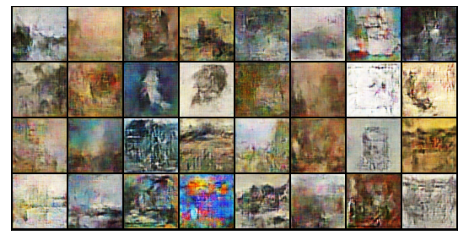

------------------------------------------------------------------------------------


/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


Epoch [841/990] | Step 150 | Batch 2/148                   Loss G: 935.6655, loss D: -26.0052, FID: 265.2338
--real images ---


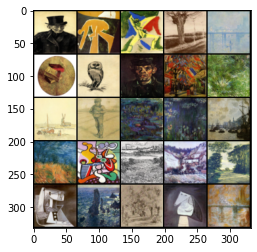

--fake images ---


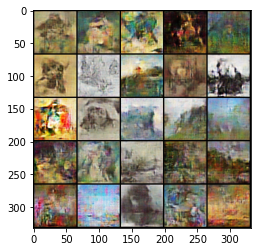

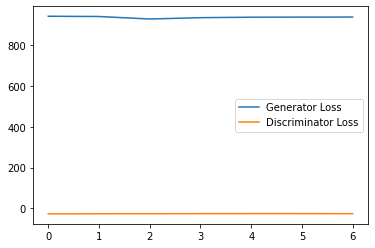

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-00150-epoch-0841.jpg
Epoch [842/990] | Step 300 | Batch 4/148                   Loss G: 933.6835, loss D: -25.9672, FID: 292.8189
--real images ---


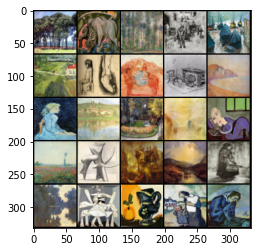

--fake images ---


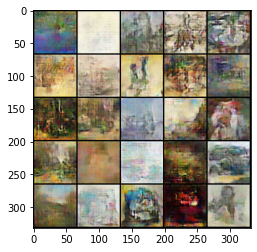

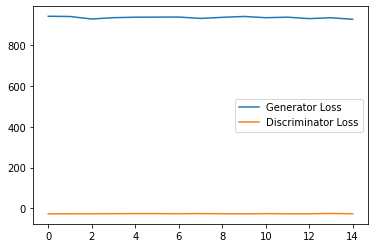

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-00300-epoch-0842.jpg
Epoch [843/990] | Step 450 | Batch 6/148                   Loss G: 934.5479, loss D: -25.9511, FID: 278.3928
--real images ---


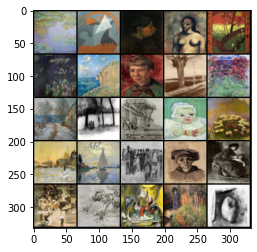

--fake images ---


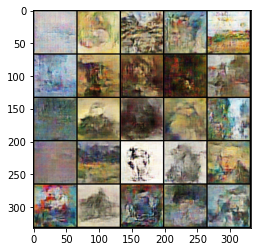

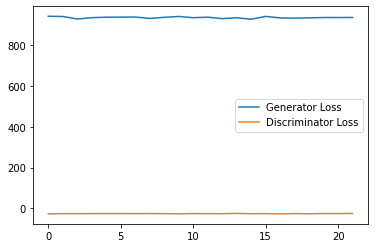

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-00450-epoch-0843.jpg
Epoch [844/990] | Step 600 | Batch 8/148                   Loss G: 932.7490, loss D: -26.0849, FID: 277.6793
--real images ---


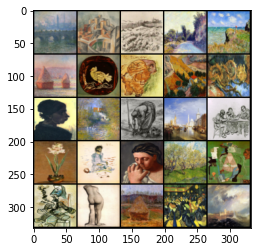

--fake images ---


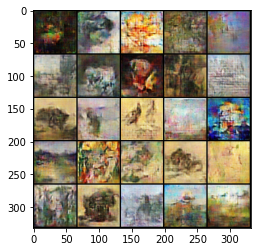

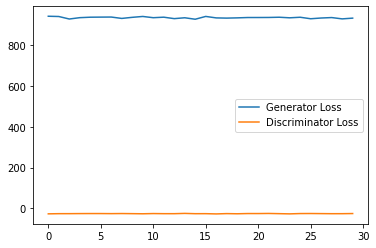

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-00600-epoch-0844.jpg
Epoch [845/990] | Step 750 | Batch 10/148                   Loss G: 933.4319, loss D: -26.0985, FID: 265.8361
--real images ---


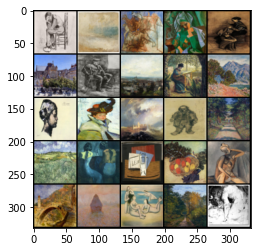

--fake images ---


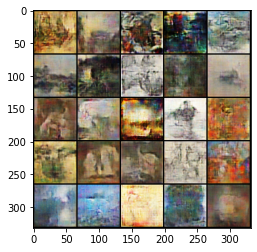

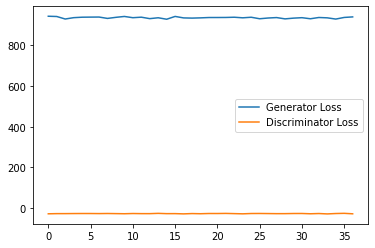

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-00750-epoch-0845.jpg
Epoch [846/990] | Step 900 | Batch 12/148                   Loss G: 932.1518, loss D: -26.1412, FID: 270.1754
--real images ---


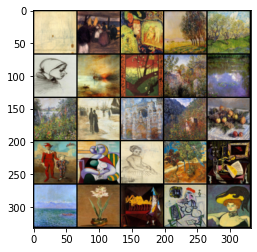

--fake images ---


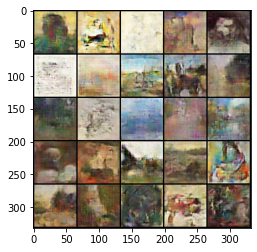

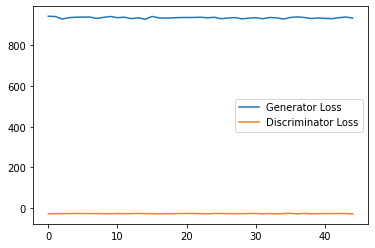

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-00900-epoch-0846.jpg
Epoch [847/990] | Step 1050 | Batch 14/148                   Loss G: 932.9982, loss D: -25.9005, FID: 282.7183
--real images ---


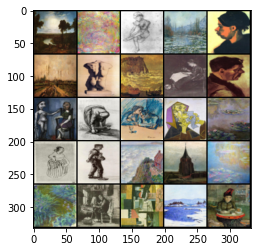

--fake images ---


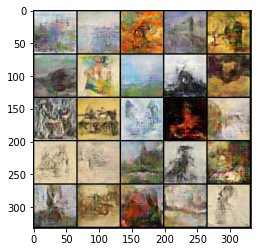

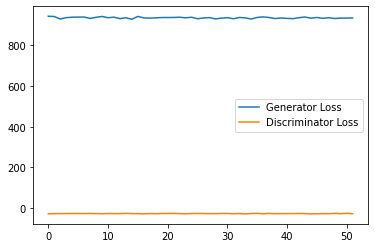

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-01050-epoch-0847.jpg
Epoch [848/990] | Step 1200 | Batch 16/148                   Loss G: 932.4207, loss D: -26.2224, FID: 280.0033
--real images ---


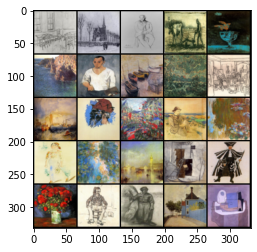

--fake images ---


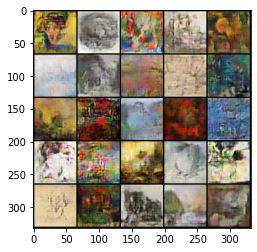

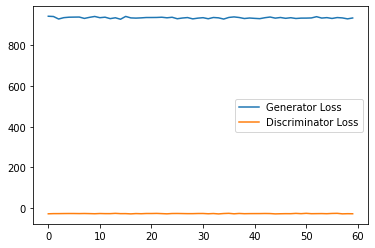

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-01200-epoch-0848.jpg
Epoch [849/990] | Step 1350 | Batch 18/148                   Loss G: 932.8645, loss D: -26.1656, FID: 283.1950
--real images ---


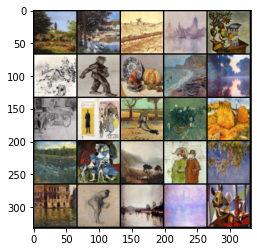

--fake images ---


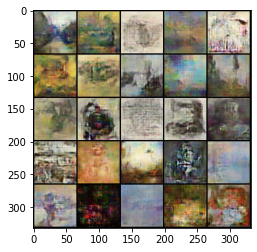

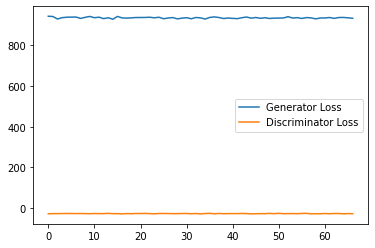

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-01350-epoch-0849.jpg
Epoch [850/990] | Step 1500 | Batch 20/148                   Loss G: 933.4716, loss D: -26.2773, FID: 273.9554
--real images ---


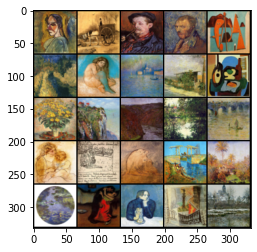

--fake images ---


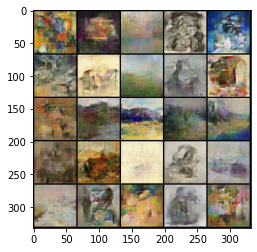

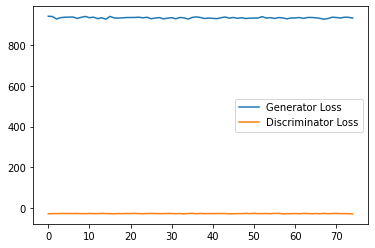

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-01500-epoch-0850.jpg
Epoch [851/990] | Step 1650 | Batch 22/148                   Loss G: 933.4538, loss D: -26.1876, FID: 300.3162
--real images ---


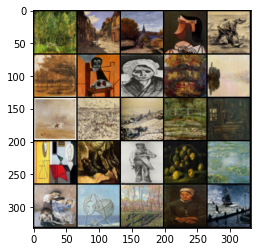

--fake images ---


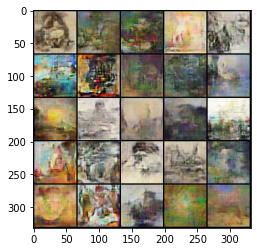

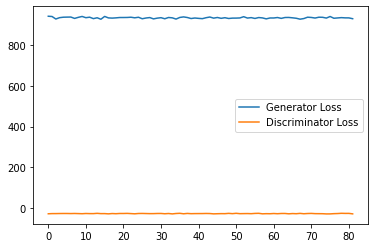

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-01650-epoch-0851.jpg
Epoch [852/990] | Step 1800 | Batch 24/148                   Loss G: 932.8986, loss D: -25.7663, FID: 287.4392
--real images ---


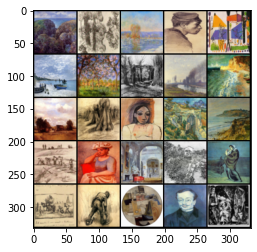

--fake images ---


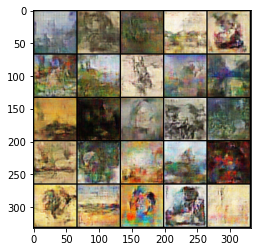

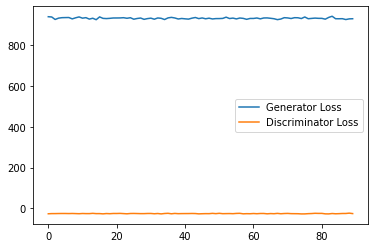

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-01800-epoch-0852.jpg
Epoch [853/990] | Step 1950 | Batch 26/148                   Loss G: 929.9432, loss D: -25.9844, FID: 306.0704
--real images ---


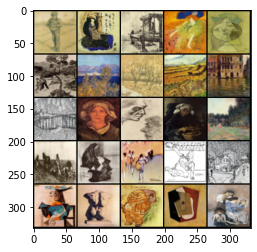

--fake images ---


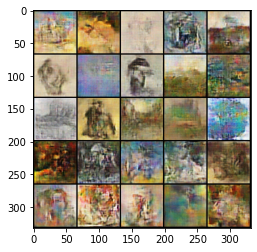

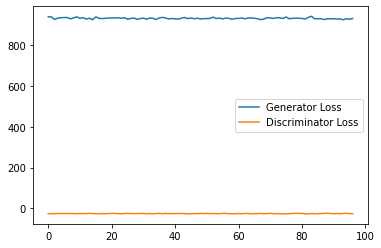

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-01950-epoch-0853.jpg
Epoch [854/990] | Step 2100 | Batch 28/148                   Loss G: 930.9747, loss D: -25.8682, FID: 285.1690
--real images ---


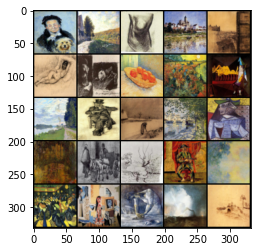

--fake images ---


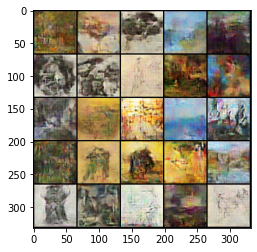

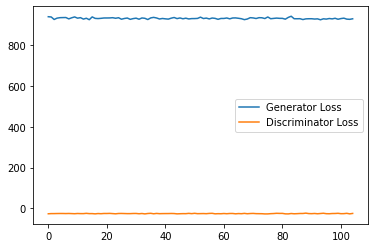

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-02100-epoch-0854.jpg
Epoch [855/990] | Step 2250 | Batch 30/148                   Loss G: 931.5396, loss D: -26.2076, FID: 279.5970
--real images ---


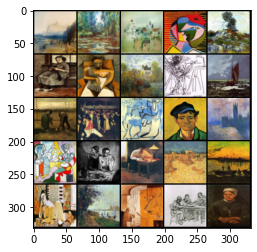

--fake images ---


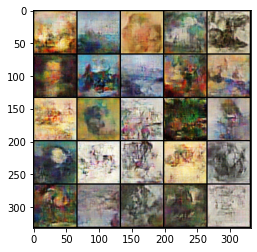

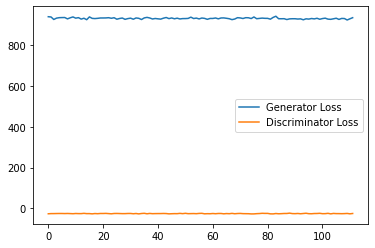

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-02250-epoch-0855.jpg
Epoch [856/990] | Step 2400 | Batch 32/148                   Loss G: 934.1046, loss D: -26.3028, FID: 282.3763
--real images ---


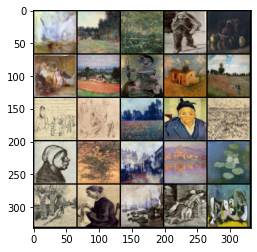

--fake images ---


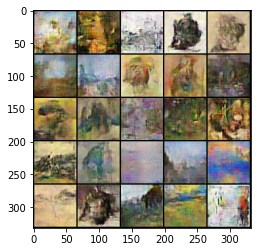

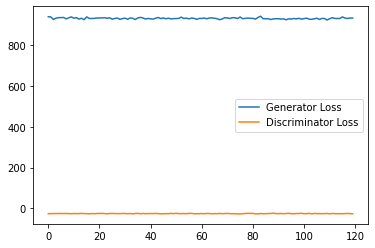

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-02400-epoch-0856.jpg
Epoch [857/990] | Step 2550 | Batch 34/148                   Loss G: 934.2185, loss D: -26.2555, FID: 259.1615
--real images ---


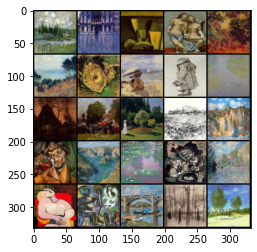

--fake images ---


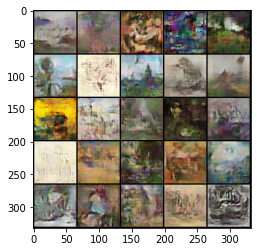

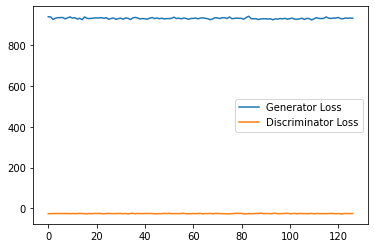

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-02550-epoch-0857.jpg
Epoch [858/990] | Step 2700 | Batch 36/148                   Loss G: 934.4209, loss D: -26.0737, FID: 288.1292
--real images ---


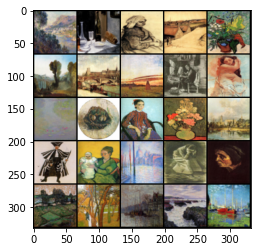

--fake images ---


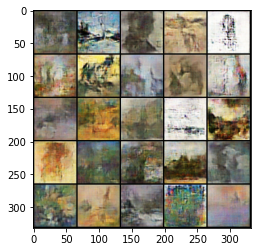

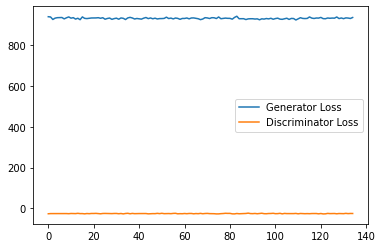

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-02700-epoch-0858.jpg
Epoch [859/990] | Step 2850 | Batch 38/148                   Loss G: 935.4279, loss D: -25.9890, FID: 273.7367
--real images ---


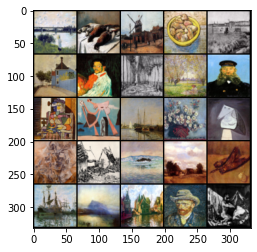

--fake images ---


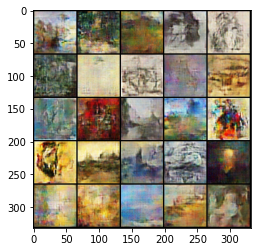

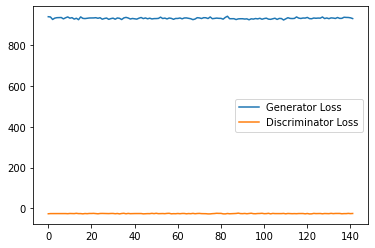

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-02850-epoch-0859.jpg
Epoch [860/990] | Step 3000 | Batch 40/148                   Loss G: 934.7360, loss D: -26.0786, FID: 262.4157
--real images ---


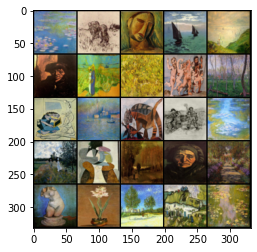

--fake images ---


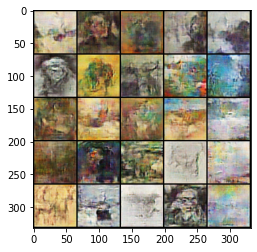

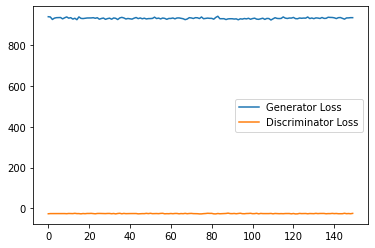

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-03000-epoch-0860.jpg
Saving Wcgan-byartist-v2-generated-images-00148-epoch-0860.jpg


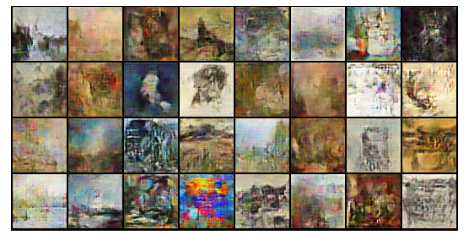

------------------------------------------------------------------------------------
Epoch [861/990] | Step 3150 | Batch 42/148                   Loss G: 935.7720, loss D: -26.5036, FID: 296.8464
--real images ---


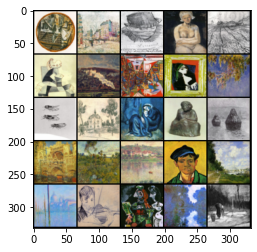

--fake images ---


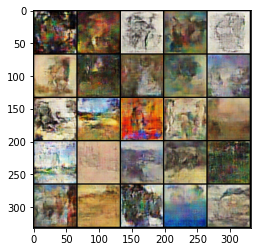

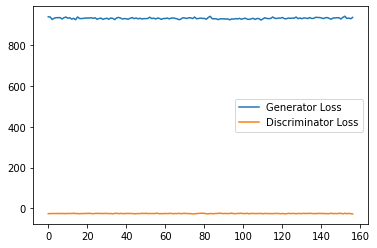

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-03150-epoch-0861.jpg
Epoch [862/990] | Step 3300 | Batch 44/148                   Loss G: 933.9233, loss D: -25.9538, FID: 283.3297
--real images ---


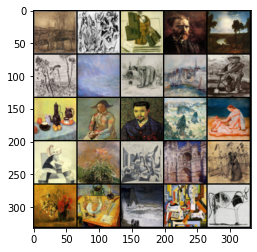

--fake images ---


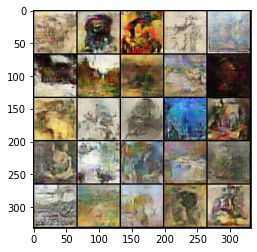

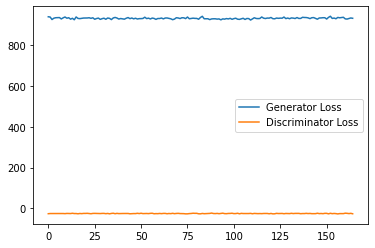

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-03300-epoch-0862.jpg
Epoch [863/990] | Step 3450 | Batch 46/148                   Loss G: 932.7992, loss D: -26.4411, FID: 251.4955
--real images ---


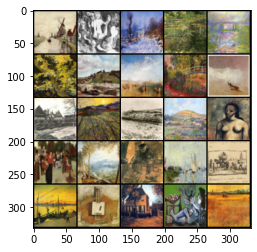

--fake images ---


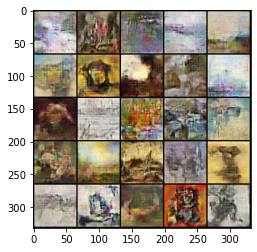

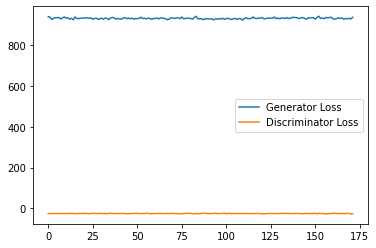

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-03450-epoch-0863.jpg
Epoch [864/990] | Step 3600 | Batch 48/148                   Loss G: 932.8204, loss D: -25.5601, FID: 285.1137
--real images ---


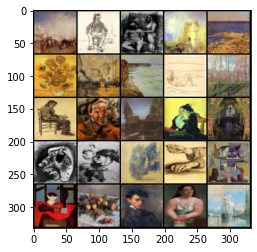

--fake images ---


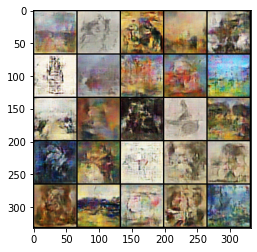

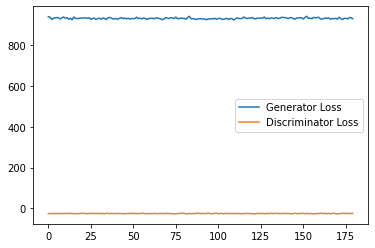

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-03600-epoch-0864.jpg
Epoch [865/990] | Step 3750 | Batch 50/148                   Loss G: 935.9165, loss D: -26.2617, FID: 283.3817
--real images ---


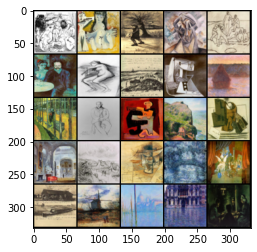

--fake images ---


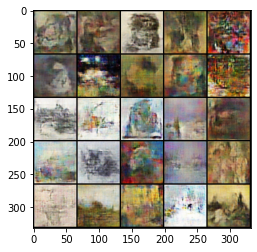

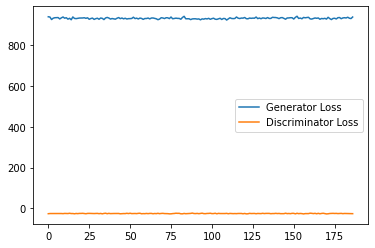

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-03750-epoch-0865.jpg
Epoch [866/990] | Step 3900 | Batch 52/148                   Loss G: 932.7355, loss D: -25.9167, FID: 292.6368
--real images ---


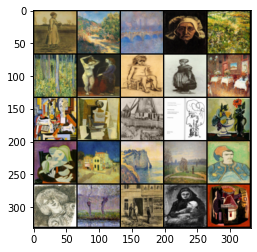

--fake images ---


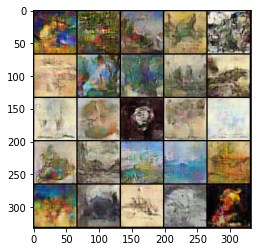

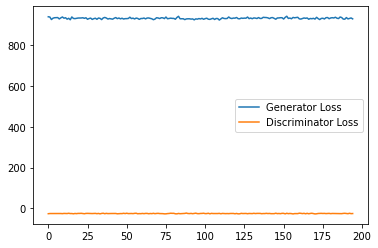

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-03900-epoch-0866.jpg
Epoch [867/990] | Step 4050 | Batch 54/148                   Loss G: 934.4175, loss D: -26.0544, FID: 269.2707
--real images ---


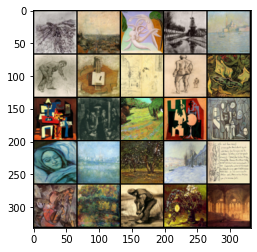

--fake images ---


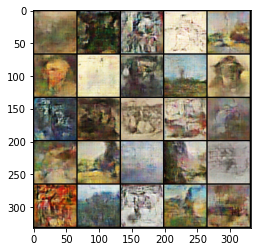

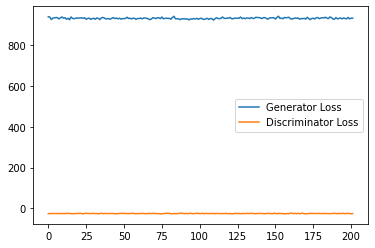

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-04050-epoch-0867.jpg
Epoch [868/990] | Step 4200 | Batch 56/148                   Loss G: 935.4803, loss D: -25.7226, FID: 266.2613
--real images ---


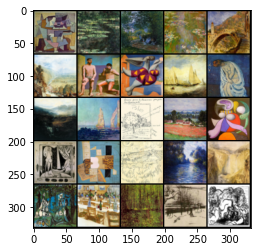

--fake images ---


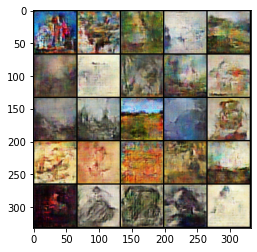

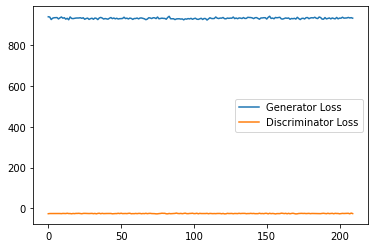

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-04200-epoch-0868.jpg
Epoch [869/990] | Step 4350 | Batch 58/148                   Loss G: 937.9254, loss D: -26.1981, FID: 274.2790
--real images ---


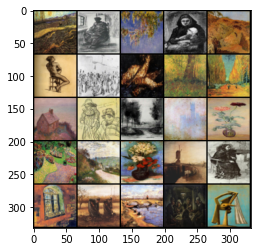

--fake images ---


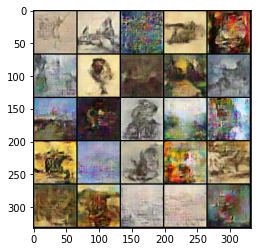

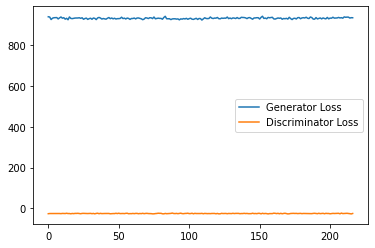

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-04350-epoch-0869.jpg
Epoch [870/990] | Step 4500 | Batch 60/148                   Loss G: 935.7848, loss D: -25.9917, FID: 276.5052
--real images ---


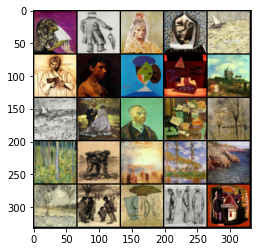

--fake images ---


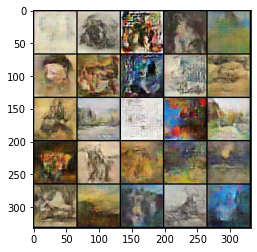

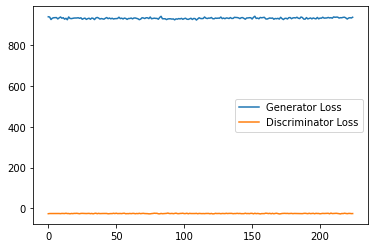

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-04500-epoch-0870.jpg
Epoch [871/990] | Step 4650 | Batch 62/148                   Loss G: 938.3212, loss D: -26.2614, FID: 270.6733
--real images ---


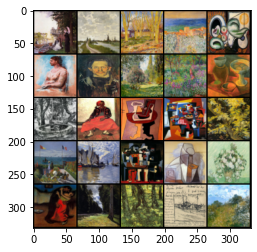

--fake images ---


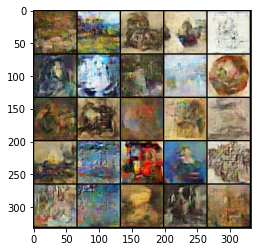

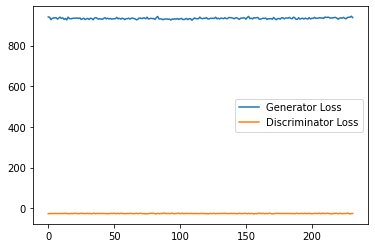

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-04650-epoch-0871.jpg
Epoch [872/990] | Step 4800 | Batch 64/148                   Loss G: 940.1173, loss D: -26.1688, FID: 290.1228
--real images ---


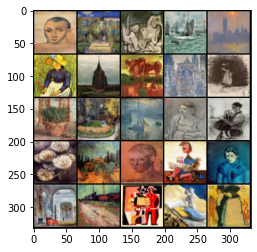

--fake images ---


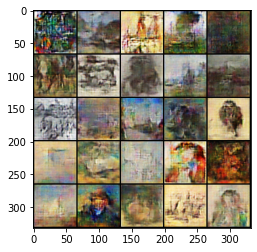

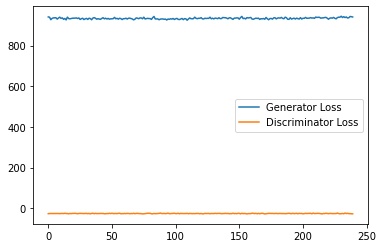

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-04800-epoch-0872.jpg
Epoch [873/990] | Step 4950 | Batch 66/148                   Loss G: 935.1390, loss D: -25.9709, FID: 269.9312
--real images ---


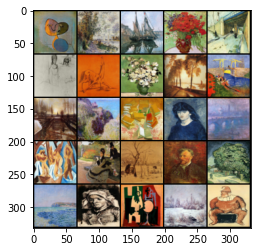

--fake images ---


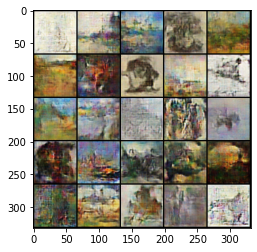

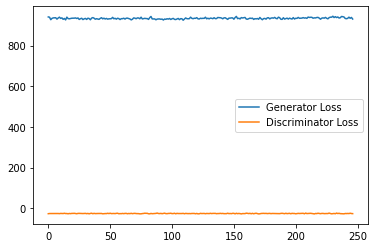

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-04950-epoch-0873.jpg
Epoch [874/990] | Step 5100 | Batch 68/148                   Loss G: 938.2994, loss D: -26.2730, FID: 277.2916
--real images ---


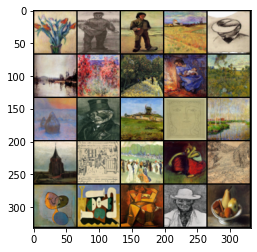

--fake images ---


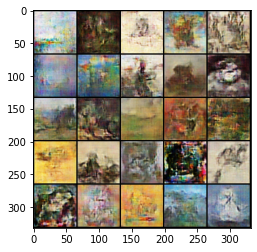

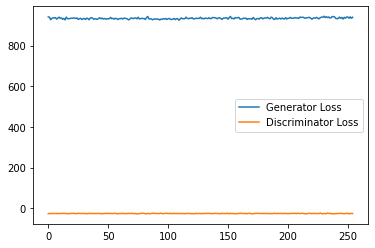

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-05100-epoch-0874.jpg
Epoch [875/990] | Step 5250 | Batch 70/148                   Loss G: 936.7364, loss D: -25.9817, FID: 284.3807
--real images ---


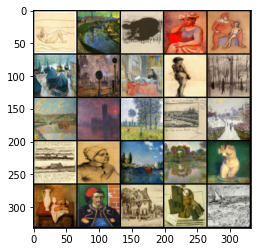

--fake images ---


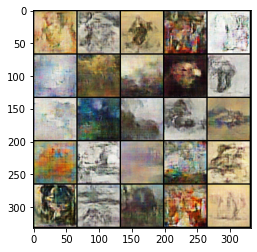

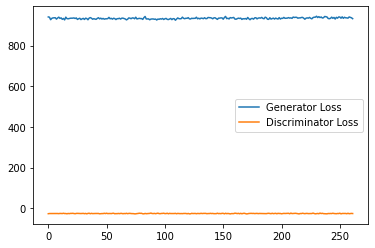

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-05250-epoch-0875.jpg
Epoch [876/990] | Step 5400 | Batch 72/148                   Loss G: 936.7965, loss D: -26.4036, FID: 295.8115
--real images ---


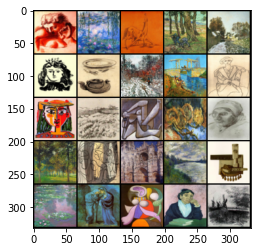

--fake images ---


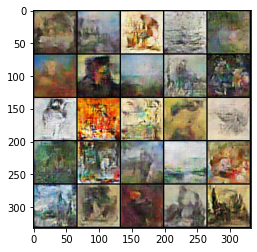

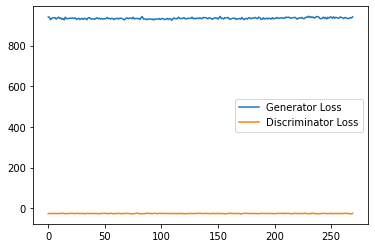

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-05400-epoch-0876.jpg
Epoch [877/990] | Step 5550 | Batch 74/148                   Loss G: 936.0415, loss D: -26.0522, FID: 286.4459
--real images ---


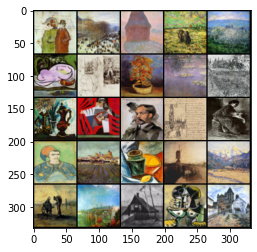

--fake images ---


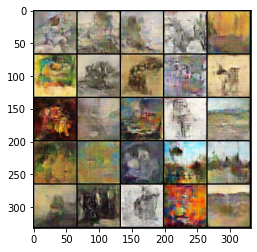

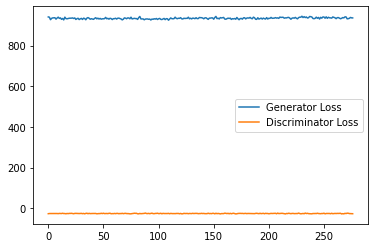

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-05550-epoch-0877.jpg
Epoch [878/990] | Step 5700 | Batch 76/148                   Loss G: 935.5291, loss D: -26.0995, FID: 276.2286
--real images ---


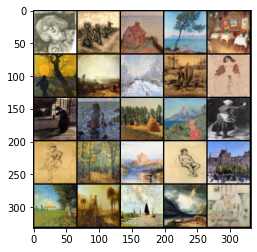

--fake images ---


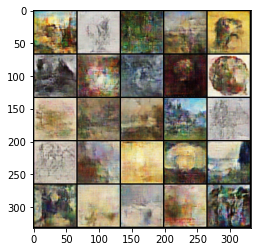

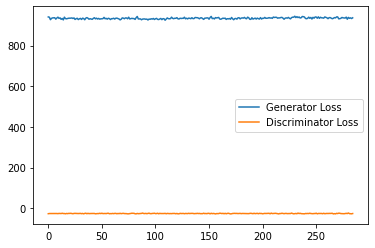

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-05700-epoch-0878.jpg
Epoch [879/990] | Step 5850 | Batch 78/148                   Loss G: 938.7698, loss D: -25.9713, FID: 318.1990
--real images ---


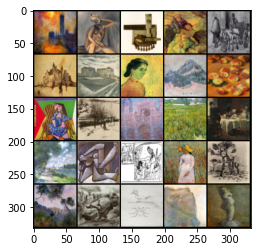

--fake images ---


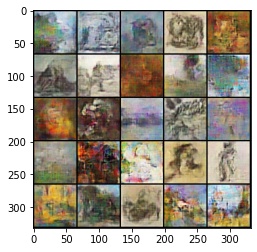

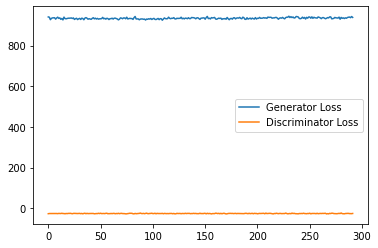

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-05850-epoch-0879.jpg
Epoch [880/990] | Step 6000 | Batch 80/148                   Loss G: 939.2232, loss D: -26.2919, FID: 295.6626
--real images ---


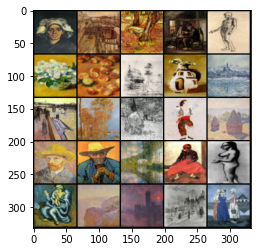

--fake images ---


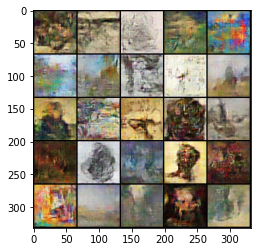

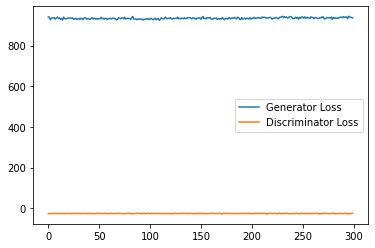

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-06000-epoch-0880.jpg
Saving Wcgan-byartist-v2-generated-images-00148-epoch-0880.jpg


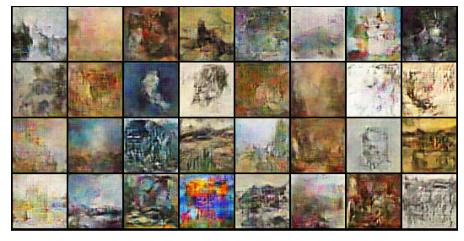

------------------------------------------------------------------------------------
Epoch [881/990] | Step 6150 | Batch 82/148                   Loss G: 938.3067, loss D: -26.0988, FID: 277.2521
--real images ---


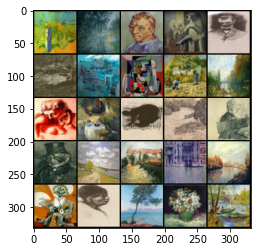

--fake images ---


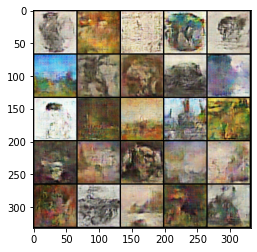

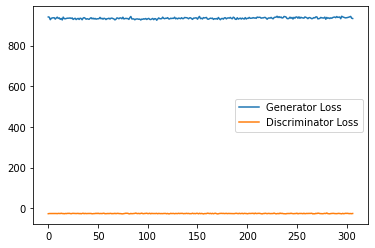

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-06150-epoch-0881.jpg
Epoch [882/990] | Step 6300 | Batch 84/148                   Loss G: 934.7152, loss D: -25.8579, FID: 273.6519
--real images ---


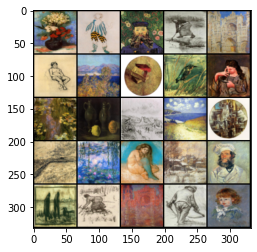

--fake images ---


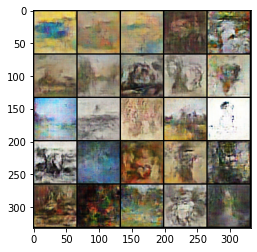

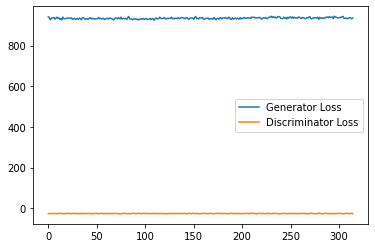

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-06300-epoch-0882.jpg
Epoch [883/990] | Step 6450 | Batch 86/148                   Loss G: 937.1440, loss D: -26.2648, FID: 283.3724
--real images ---


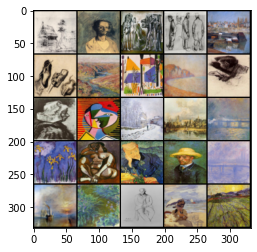

--fake images ---


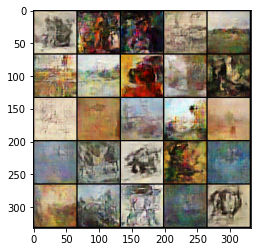

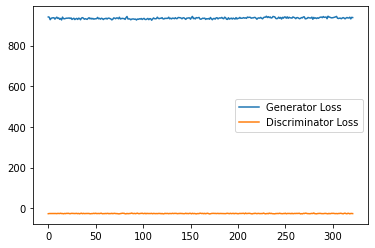

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-06450-epoch-0883.jpg
Epoch [884/990] | Step 6600 | Batch 88/148                   Loss G: 935.6702, loss D: -25.9053, FID: 258.4185
--real images ---


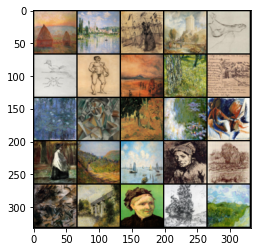

--fake images ---


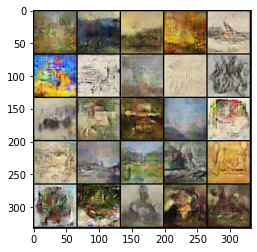

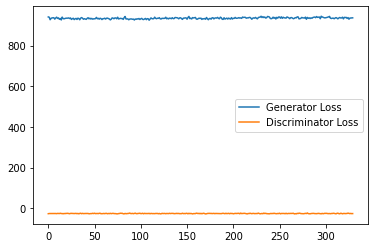

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-06600-epoch-0884.jpg
Epoch [885/990] | Step 6750 | Batch 90/148                   Loss G: 938.7195, loss D: -26.0009, FID: 272.7920
--real images ---


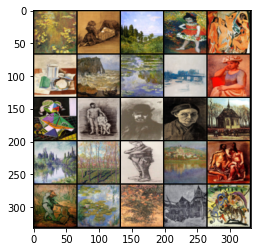

--fake images ---


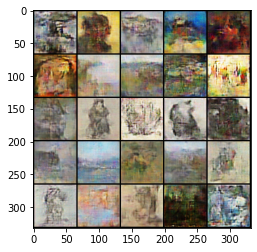

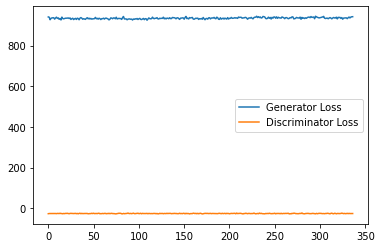

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-06750-epoch-0885.jpg
Epoch [886/990] | Step 6900 | Batch 92/148                   Loss G: 937.0695, loss D: -26.0414, FID: 262.2653
--real images ---


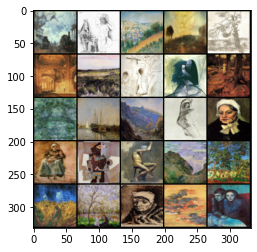

--fake images ---


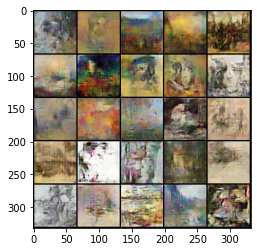

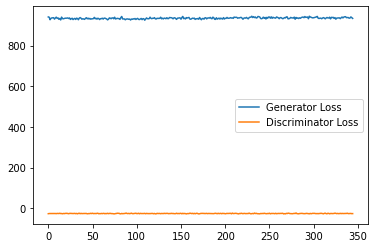

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-06900-epoch-0886.jpg
Epoch [887/990] | Step 7050 | Batch 94/148                   Loss G: 937.3274, loss D: -25.7422, FID: 266.9078
--real images ---


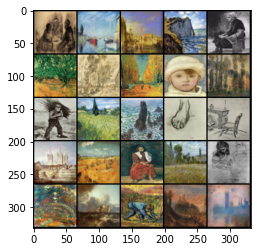

--fake images ---


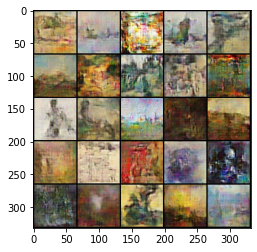

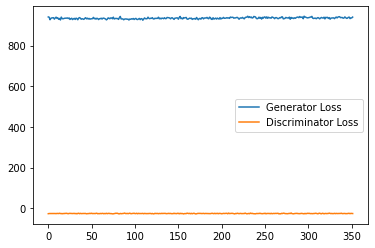

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-07050-epoch-0887.jpg
Epoch [888/990] | Step 7200 | Batch 96/148                   Loss G: 937.2893, loss D: -25.9066, FID: 275.7705
--real images ---


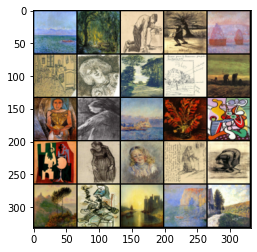

--fake images ---


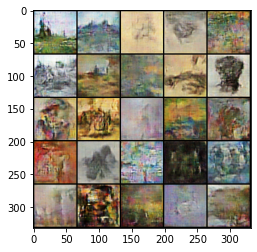

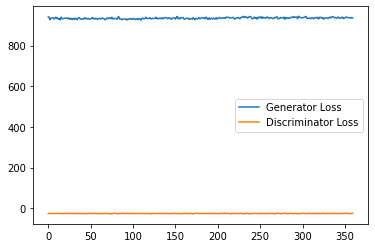

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-07200-epoch-0888.jpg
Epoch [889/990] | Step 7350 | Batch 98/148                   Loss G: 936.8700, loss D: -26.4117, FID: 256.6505
--real images ---


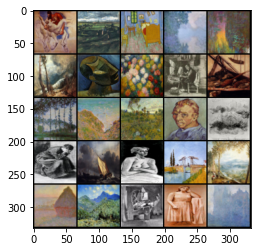

--fake images ---


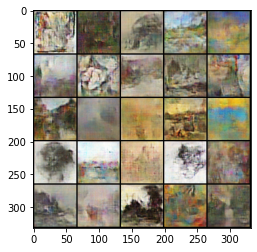

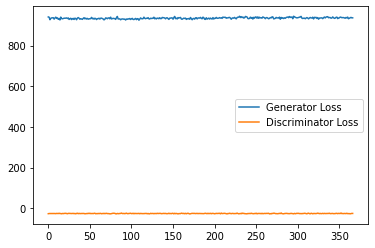

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-07350-epoch-0889.jpg
Epoch [890/990] | Step 7500 | Batch 100/148                   Loss G: 938.3687, loss D: -25.9925, FID: 306.0285
--real images ---


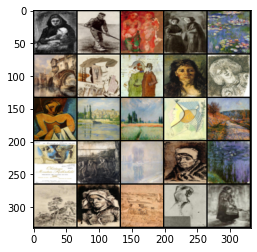

--fake images ---


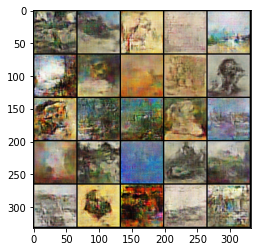

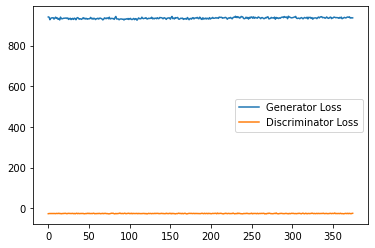

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-07500-epoch-0890.jpg
Epoch [891/990] | Step 7650 | Batch 102/148                   Loss G: 938.5030, loss D: -26.4150, FID: 256.4377
--real images ---


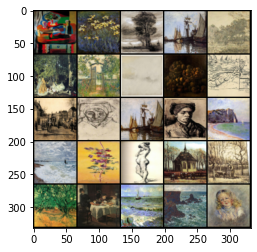

--fake images ---


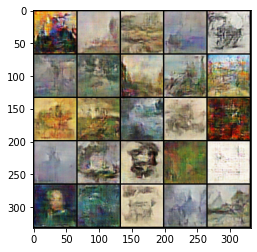

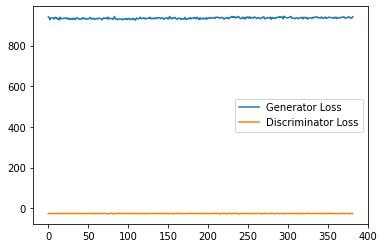

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-07650-epoch-0891.jpg
Epoch [892/990] | Step 7800 | Batch 104/148                   Loss G: 937.3189, loss D: -26.2614, FID: 285.9756
--real images ---


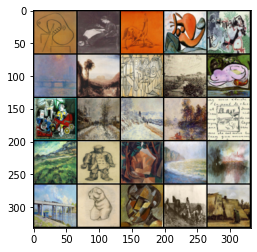

--fake images ---


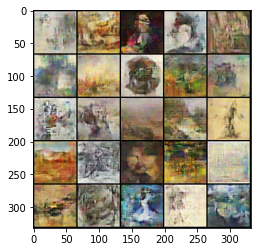

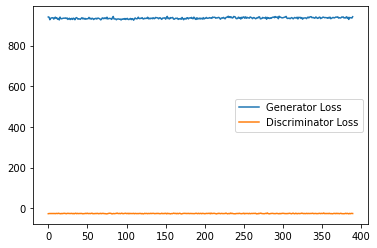

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-07800-epoch-0892.jpg
Epoch [893/990] | Step 7950 | Batch 106/148                   Loss G: 939.0665, loss D: -26.5207, FID: 262.0667
--real images ---


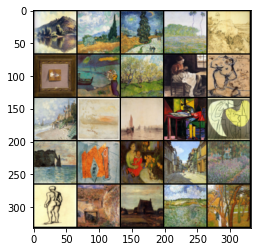

--fake images ---


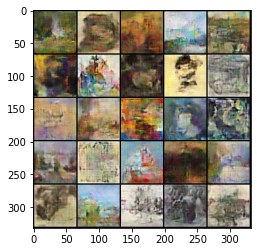

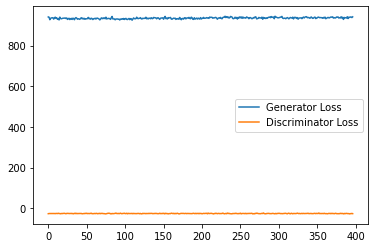

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-07950-epoch-0893.jpg
Epoch [894/990] | Step 8100 | Batch 108/148                   Loss G: 940.0894, loss D: -26.4748, FID: 278.6977
--real images ---


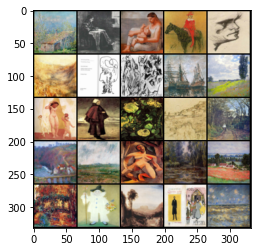

--fake images ---


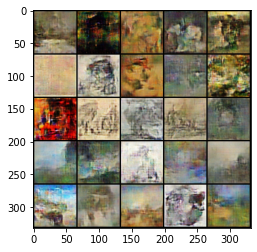

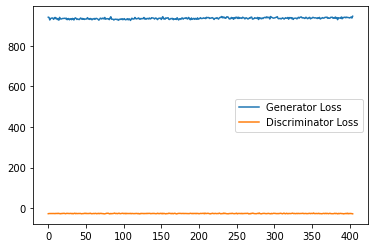

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-08100-epoch-0894.jpg
Epoch [895/990] | Step 8250 | Batch 110/148                   Loss G: 940.8822, loss D: -25.9024, FID: 253.9591
--real images ---


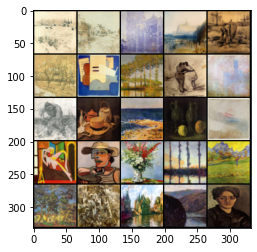

--fake images ---


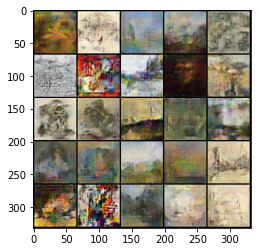

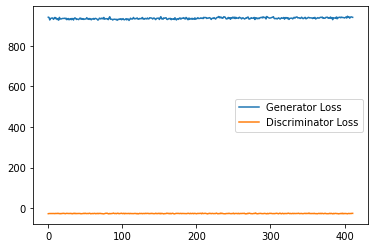

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-08250-epoch-0895.jpg
Epoch [896/990] | Step 8400 | Batch 112/148                   Loss G: 938.9378, loss D: -26.2392, FID: 264.6748
--real images ---


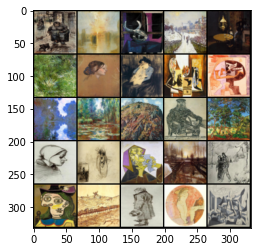

--fake images ---


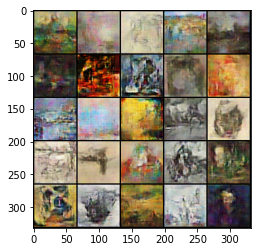

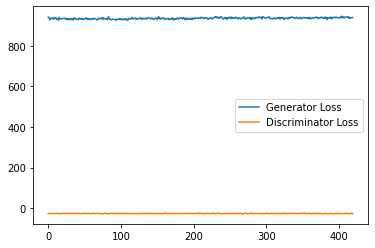

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-08400-epoch-0896.jpg
Epoch [897/990] | Step 8550 | Batch 114/148                   Loss G: 938.0097, loss D: -26.0629, FID: 295.9954
--real images ---


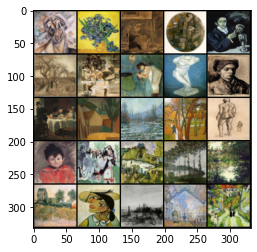

--fake images ---


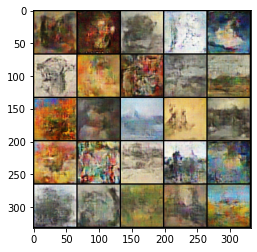

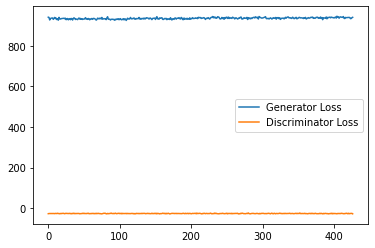

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-08550-epoch-0897.jpg
Epoch [898/990] | Step 8700 | Batch 116/148                   Loss G: 940.9936, loss D: -26.4626, FID: 247.6602
--real images ---


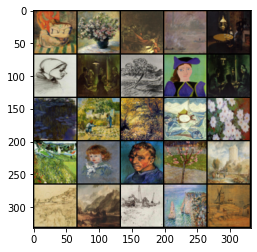

--fake images ---


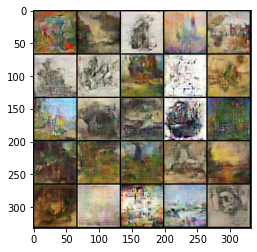

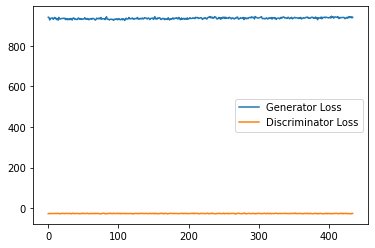

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-08700-epoch-0898.jpg
Epoch [899/990] | Step 8850 | Batch 118/148                   Loss G: 940.4505, loss D: -25.6938, FID: 300.8498
--real images ---


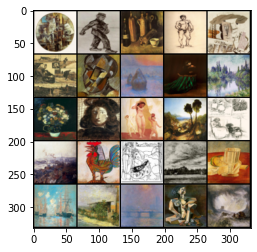

--fake images ---


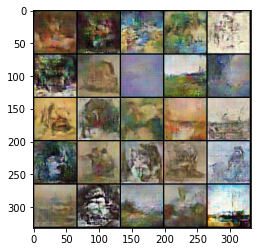

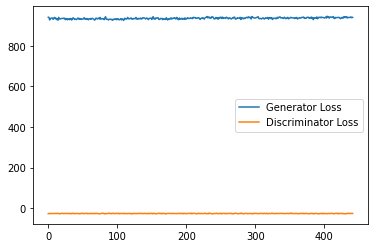

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-08850-epoch-0899.jpg
Epoch [900/990] | Step 9000 | Batch 120/148                   Loss G: 941.5250, loss D: -26.2289, FID: 268.8151
--real images ---


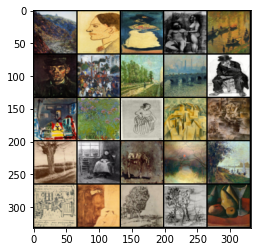

--fake images ---


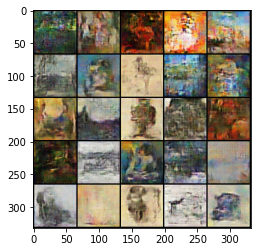

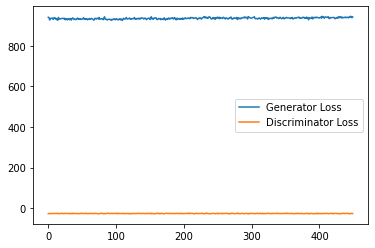

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-09000-epoch-0900.jpg
Saving Wcgan-byartist-v2-generated-images-00148-epoch-0900.jpg


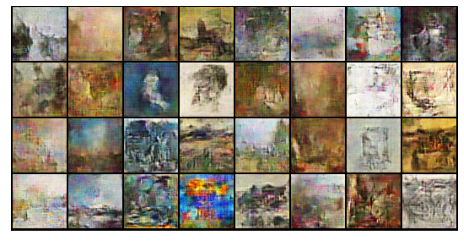

------------------------------------------------------------------------------------
Epoch [901/990] | Step 9150 | Batch 122/148                   Loss G: 940.6185, loss D: -26.1700, FID: 276.4327
--real images ---


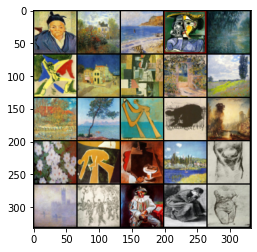

--fake images ---


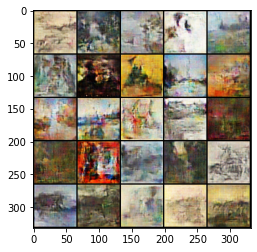

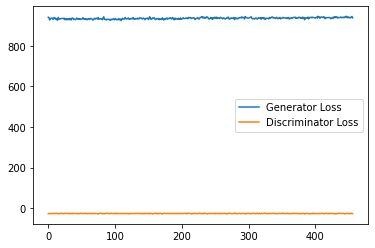

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-09150-epoch-0901.jpg
Epoch [902/990] | Step 9300 | Batch 124/148                   Loss G: 941.2312, loss D: -25.9120, FID: 281.8497
--real images ---


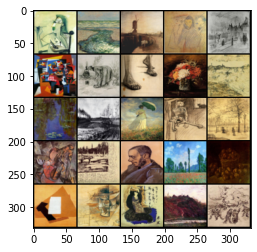

--fake images ---


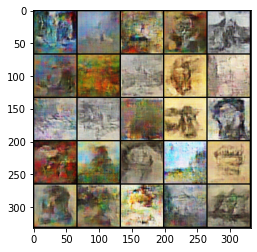

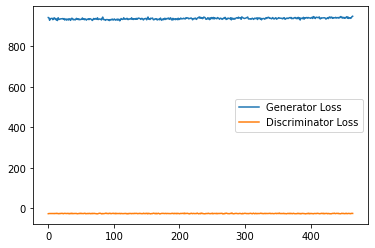

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-09300-epoch-0902.jpg
Epoch [903/990] | Step 9450 | Batch 126/148                   Loss G: 943.8309, loss D: -25.9738, FID: 318.0770
--real images ---


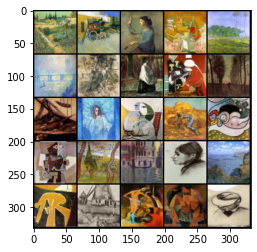

--fake images ---


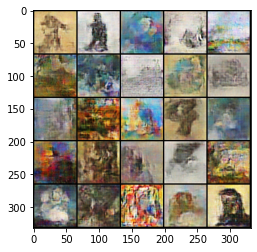

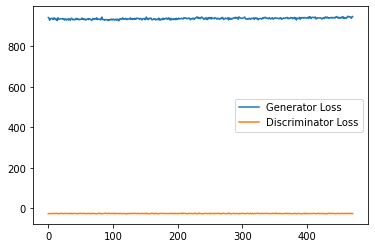

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-09450-epoch-0903.jpg
Epoch [904/990] | Step 9600 | Batch 128/148                   Loss G: 941.4730, loss D: -26.1589, FID: 264.1596
--real images ---


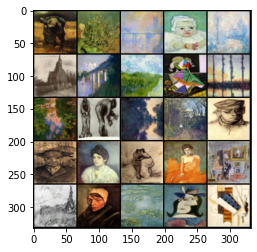

--fake images ---


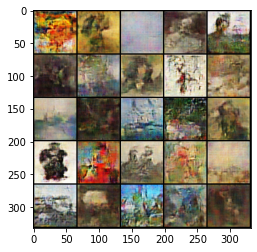

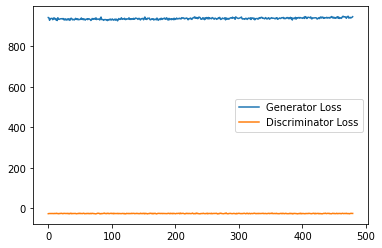

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-09600-epoch-0904.jpg
Epoch [905/990] | Step 9750 | Batch 130/148                   Loss G: 942.8031, loss D: -26.2098, FID: 283.8522
--real images ---


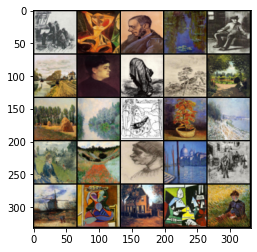

--fake images ---


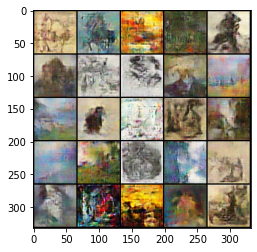

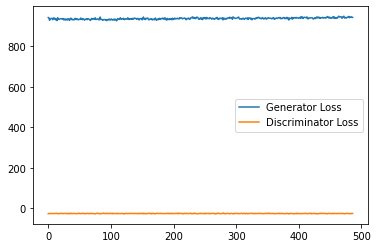

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-09750-epoch-0905.jpg
Epoch [906/990] | Step 9900 | Batch 132/148                   Loss G: 940.8831, loss D: -26.1978, FID: 250.8085
--real images ---


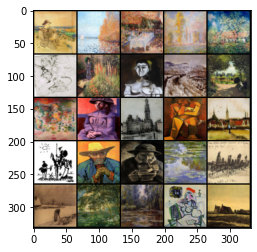

--fake images ---


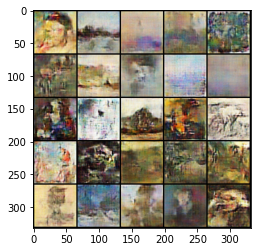

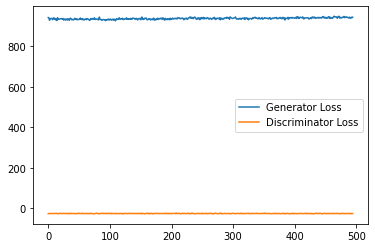

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-09900-epoch-0906.jpg
Epoch [907/990] | Step 10050 | Batch 134/148                   Loss G: 946.9551, loss D: -26.0871, FID: 270.3117
--real images ---


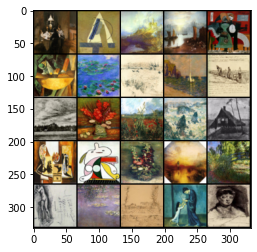

--fake images ---


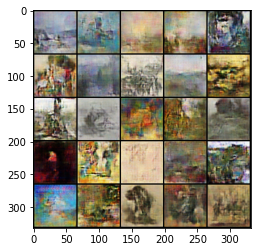

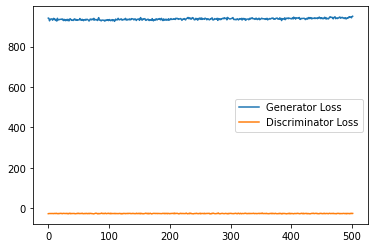

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-10050-epoch-0907.jpg
Epoch [908/990] | Step 10200 | Batch 136/148                   Loss G: 945.4526, loss D: -26.1588, FID: 283.1812
--real images ---


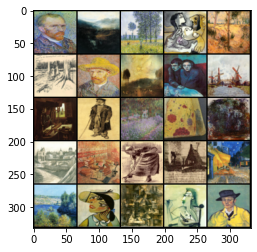

--fake images ---


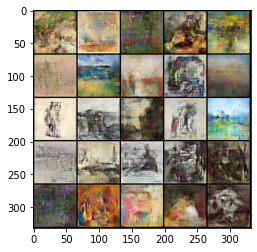

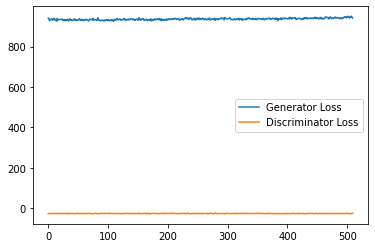

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-10200-epoch-0908.jpg
Epoch [909/990] | Step 10350 | Batch 138/148                   Loss G: 946.5490, loss D: -26.1562, FID: 277.5421
--real images ---


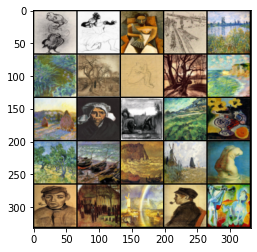

--fake images ---


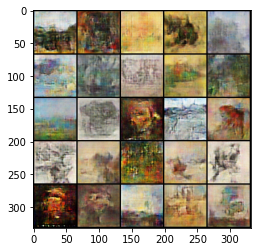

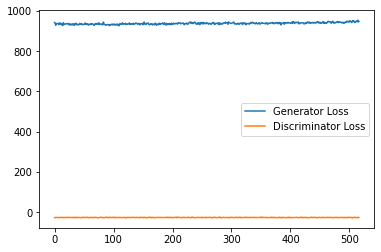

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-10350-epoch-0909.jpg
Epoch [910/990] | Step 10500 | Batch 140/148                   Loss G: 944.0614, loss D: -26.2237, FID: 264.3641
--real images ---


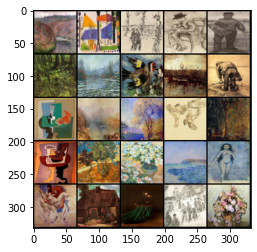

--fake images ---


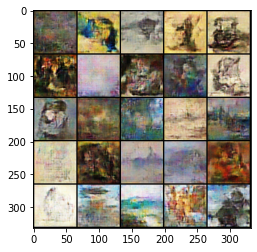

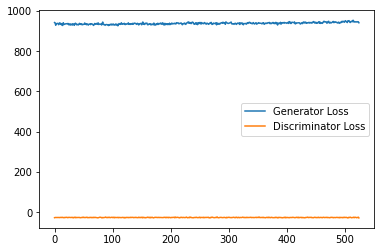

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-10500-epoch-0910.jpg
Epoch [911/990] | Step 10650 | Batch 142/148                   Loss G: 943.1285, loss D: -26.1978, FID: 269.1060
--real images ---


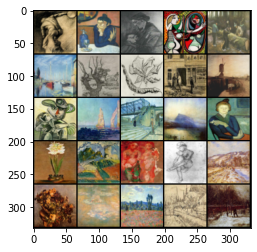

--fake images ---


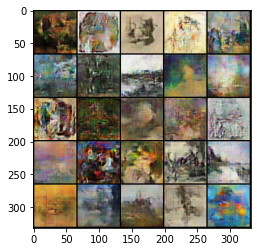

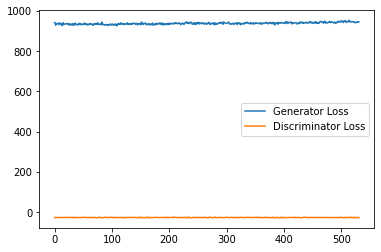

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-10650-epoch-0911.jpg
Epoch [912/990] | Step 10800 | Batch 144/148                   Loss G: 946.6804, loss D: -25.9545, FID: 268.7398
--real images ---


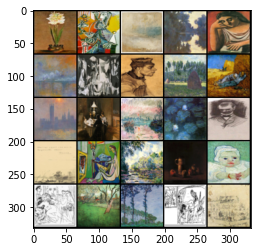

--fake images ---


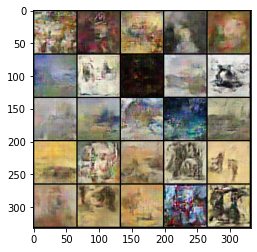

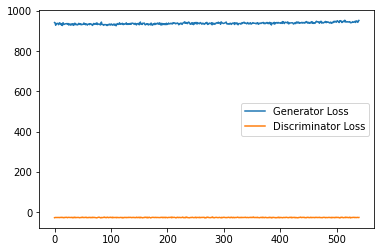

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-10800-epoch-0912.jpg
Epoch [913/990] | Step 10950 | Batch 146/148                   Loss G: 947.2618, loss D: -26.2192, FID: 288.9007
--real images ---


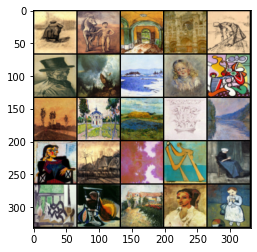

--fake images ---


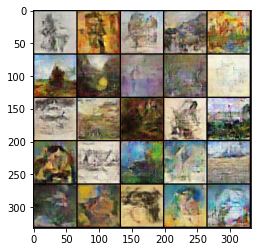

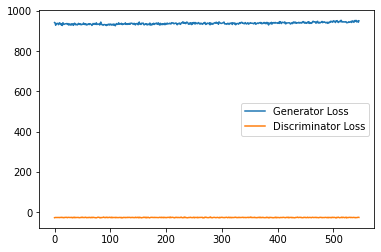

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-10950-epoch-0913.jpg
Epoch [915/990] | Step 11100 | Batch 0/148                   Loss G: 947.5796, loss D: -25.9945, FID: 307.6252
--real images ---


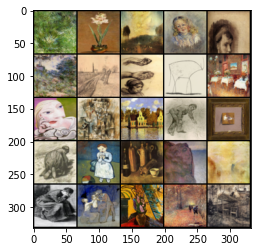

--fake images ---


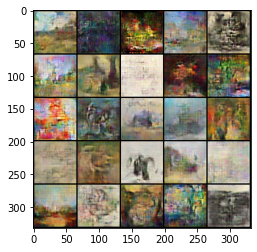

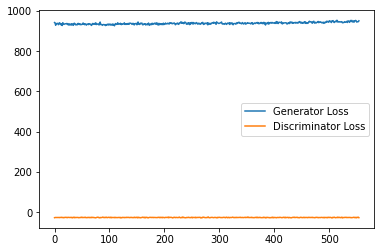

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-11100-epoch-0915.jpg
Epoch [916/990] | Step 11250 | Batch 2/148                   Loss G: 947.1376, loss D: -26.4064, FID: 281.7109
--real images ---


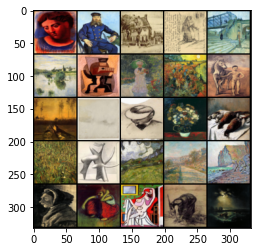

--fake images ---


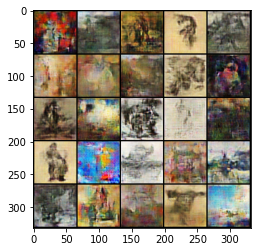

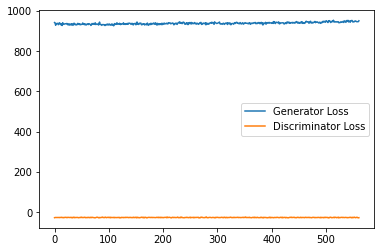

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-11250-epoch-0916.jpg
Epoch [917/990] | Step 11400 | Batch 4/148                   Loss G: 948.5639, loss D: -26.2620, FID: 271.6121
--real images ---


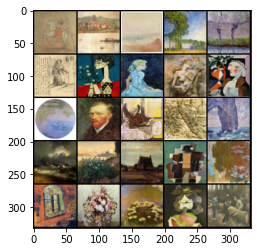

--fake images ---


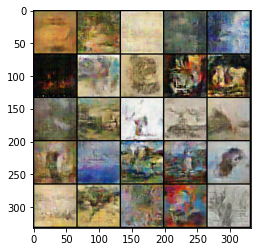

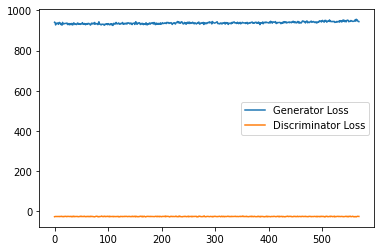

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-11400-epoch-0917.jpg
Epoch [918/990] | Step 11550 | Batch 6/148                   Loss G: 945.0508, loss D: -26.3486, FID: 290.6911
--real images ---


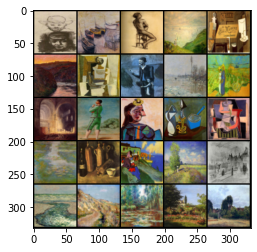

--fake images ---


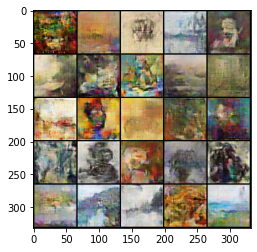

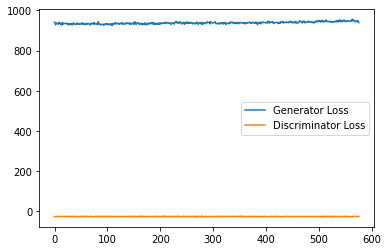

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-11550-epoch-0918.jpg
Epoch [919/990] | Step 11700 | Batch 8/148                   Loss G: 945.8130, loss D: -26.0647, FID: 285.1037
--real images ---


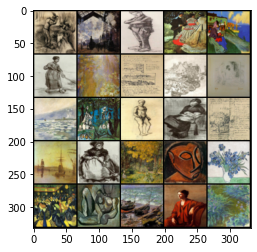

--fake images ---


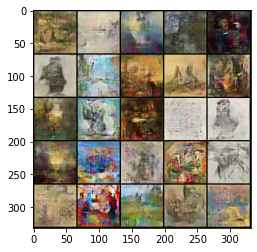

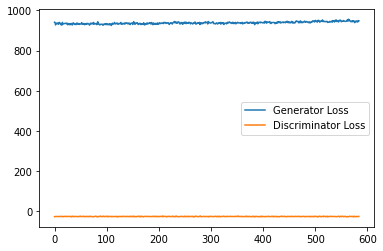

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-11700-epoch-0919.jpg
Epoch [920/990] | Step 11850 | Batch 10/148                   Loss G: 947.6703, loss D: -26.2055, FID: 287.2391
--real images ---


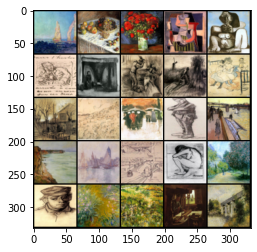

--fake images ---


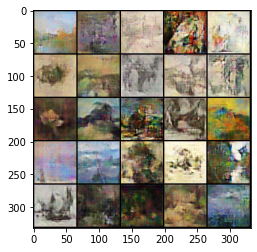

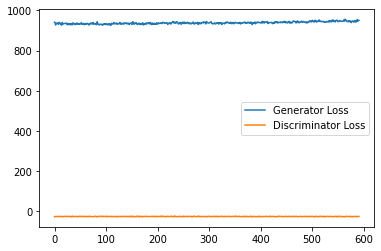

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-11850-epoch-0920.jpg
Saving Wcgan-byartist-v2-generated-images-00148-epoch-0920.jpg


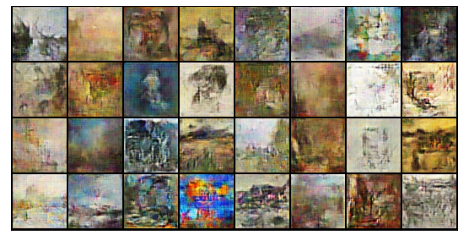

------------------------------------------------------------------------------------
Epoch [921/990] | Step 12000 | Batch 12/148                   Loss G: 947.3804, loss D: -26.3817, FID: 292.2802
--real images ---


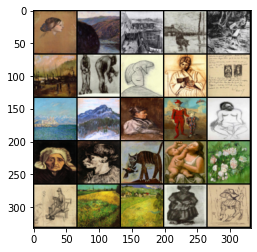

--fake images ---


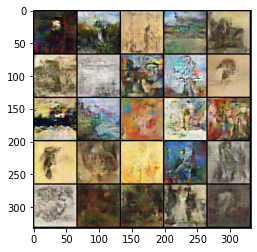

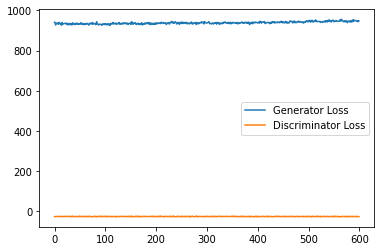

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-12000-epoch-0921.jpg
Epoch [922/990] | Step 12150 | Batch 14/148                   Loss G: 946.1453, loss D: -26.2489, FID: 274.8223
--real images ---


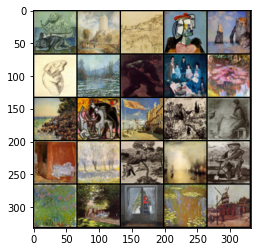

--fake images ---


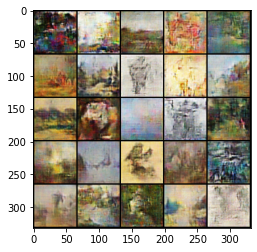

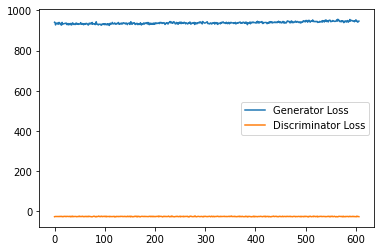

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-12150-epoch-0922.jpg
Epoch [923/990] | Step 12300 | Batch 16/148                   Loss G: 949.0257, loss D: -26.2374, FID: 279.6208
--real images ---


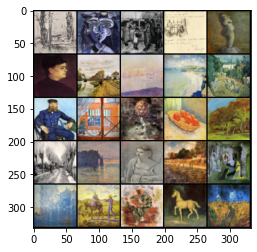

--fake images ---


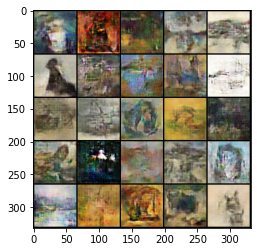

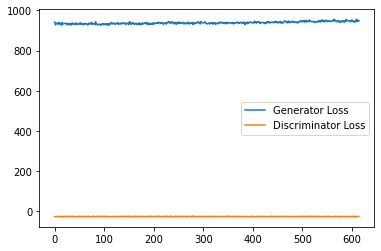

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-12300-epoch-0923.jpg
Epoch [924/990] | Step 12450 | Batch 18/148                   Loss G: 949.1258, loss D: -26.3465, FID: 274.3873
--real images ---


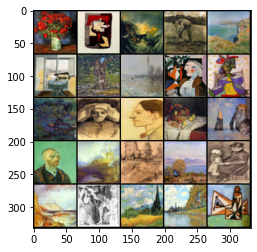

--fake images ---


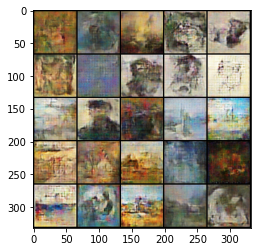

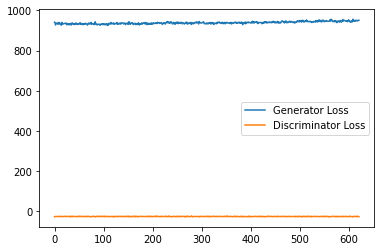

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-12450-epoch-0924.jpg
Epoch [925/990] | Step 12600 | Batch 20/148                   Loss G: 948.4750, loss D: -25.7652, FID: 310.5590
--real images ---


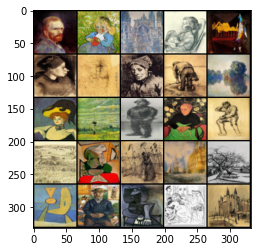

--fake images ---


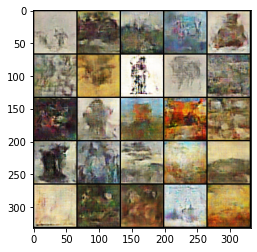

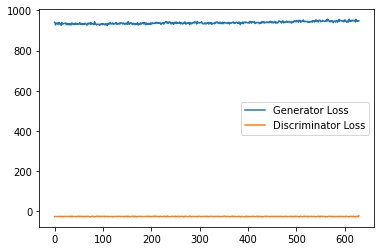

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-12600-epoch-0925.jpg
Epoch [926/990] | Step 12750 | Batch 22/148                   Loss G: 948.8994, loss D: -26.1132, FID: 263.8754
--real images ---


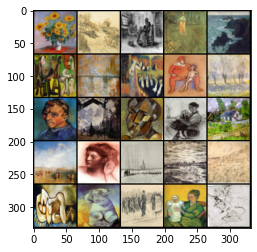

--fake images ---


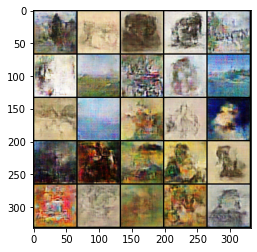

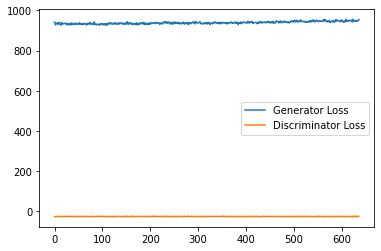

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-12750-epoch-0926.jpg
Epoch [927/990] | Step 12900 | Batch 24/148                   Loss G: 948.6457, loss D: -26.3312, FID: 276.4742
--real images ---


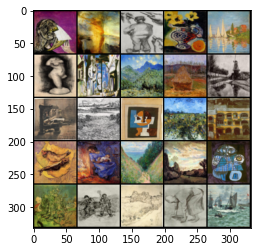

--fake images ---


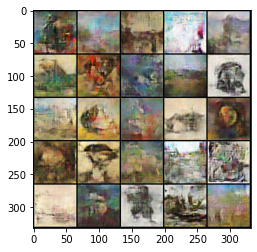

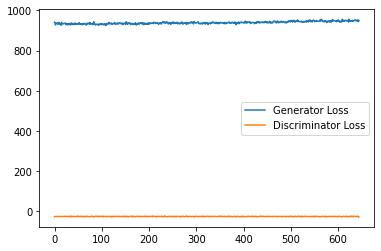

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-12900-epoch-0927.jpg
Epoch [928/990] | Step 13050 | Batch 26/148                   Loss G: 946.6748, loss D: -26.3480, FID: 270.9893
--real images ---


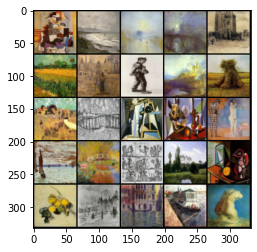

--fake images ---


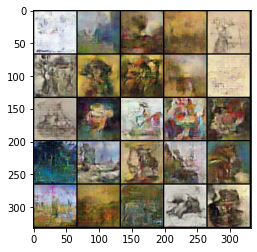

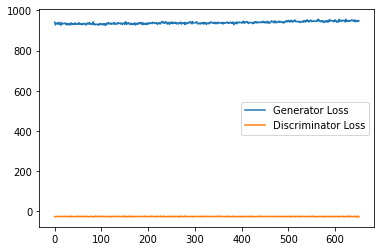

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-13050-epoch-0928.jpg
Epoch [929/990] | Step 13200 | Batch 28/148                   Loss G: 951.9703, loss D: -26.3192, FID: 287.8215
--real images ---


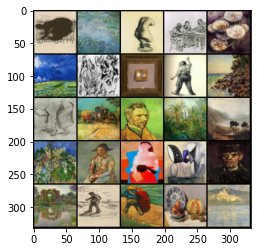

--fake images ---


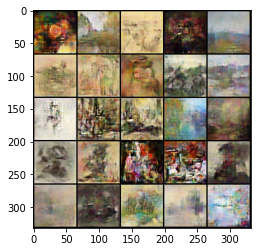

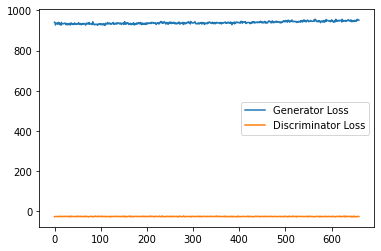

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-13200-epoch-0929.jpg
Epoch [930/990] | Step 13350 | Batch 30/148                   Loss G: 947.8903, loss D: -26.1877, FID: 270.2903
--real images ---


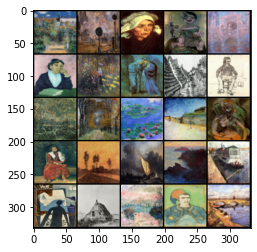

--fake images ---


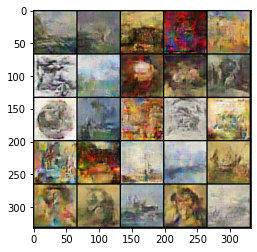

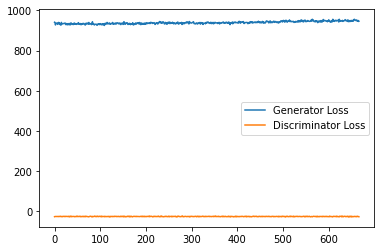

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-13350-epoch-0930.jpg
Epoch [931/990] | Step 13500 | Batch 32/148                   Loss G: 946.9980, loss D: -26.1497, FID: 292.1569
--real images ---


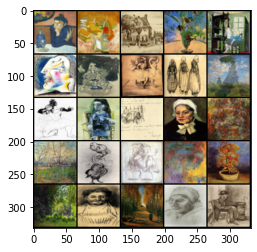

--fake images ---


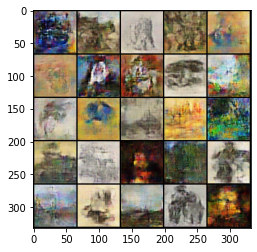

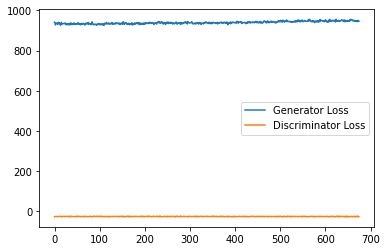

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-13500-epoch-0931.jpg
Epoch [932/990] | Step 13650 | Batch 34/148                   Loss G: 955.7007, loss D: -26.2191, FID: 277.2475
--real images ---


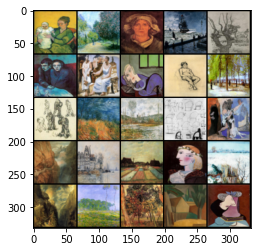

--fake images ---


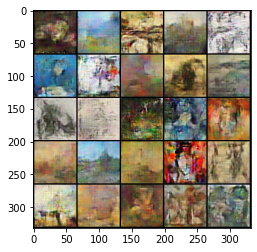

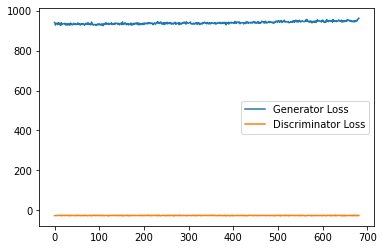

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-13650-epoch-0932.jpg
Epoch [933/990] | Step 13800 | Batch 36/148                   Loss G: 960.7861, loss D: -26.3311, FID: 290.5357
--real images ---


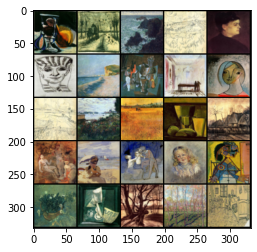

--fake images ---


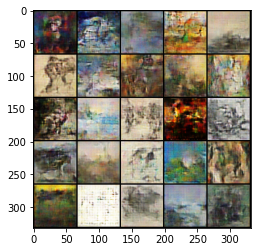

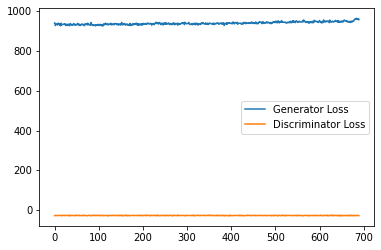

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-13800-epoch-0933.jpg
Epoch [934/990] | Step 13950 | Batch 38/148                   Loss G: 956.9915, loss D: -26.1275, FID: 249.2560
--real images ---


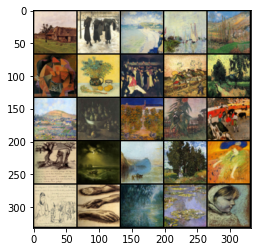

--fake images ---


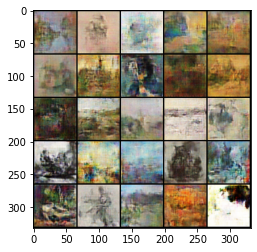

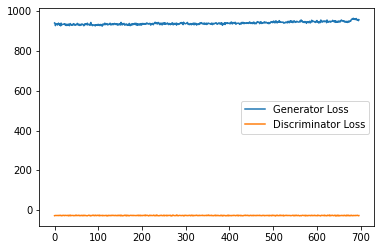

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-13950-epoch-0934.jpg
Epoch [935/990] | Step 14100 | Batch 40/148                   Loss G: 957.1325, loss D: -26.2566, FID: 236.8210
--real images ---


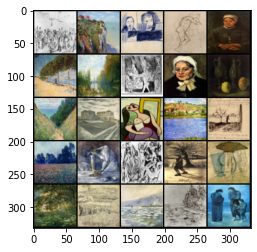

--fake images ---


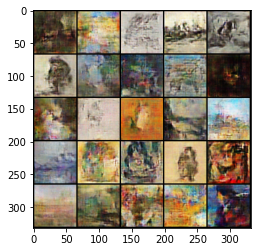

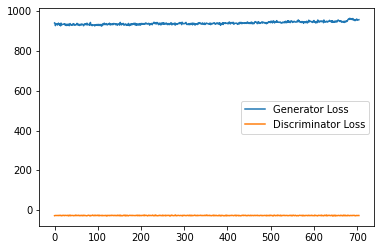

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-14100-epoch-0935.jpg
Epoch [936/990] | Step 14250 | Batch 42/148                   Loss G: 957.2654, loss D: -26.3451, FID: 293.1370
--real images ---


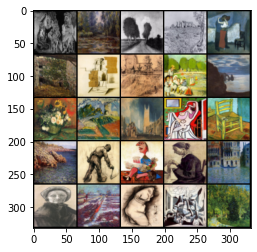

--fake images ---


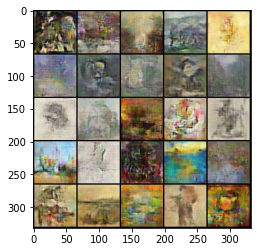

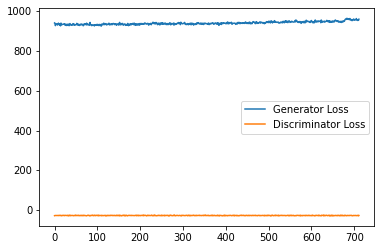

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-14250-epoch-0936.jpg
Epoch [937/990] | Step 14400 | Batch 44/148                   Loss G: 958.8670, loss D: -26.1410, FID: 287.5286
--real images ---


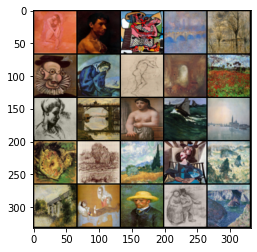

--fake images ---


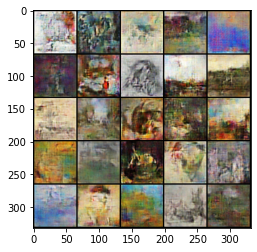

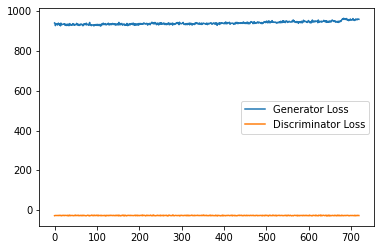

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-14400-epoch-0937.jpg
Epoch [938/990] | Step 14550 | Batch 46/148                   Loss G: 961.0049, loss D: -26.2752, FID: 289.4934
--real images ---


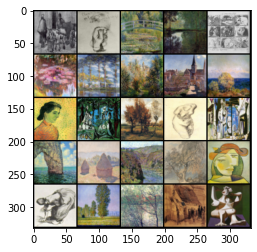

--fake images ---


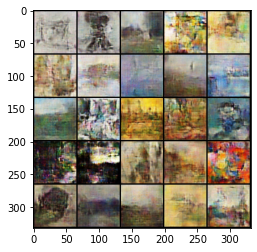

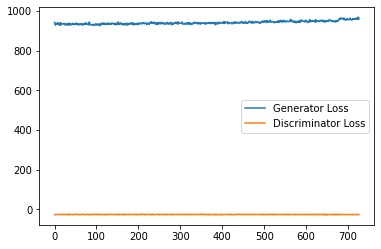

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-14550-epoch-0938.jpg
Epoch [939/990] | Step 14700 | Batch 48/148                   Loss G: 959.1360, loss D: -26.1875, FID: 274.3710
--real images ---


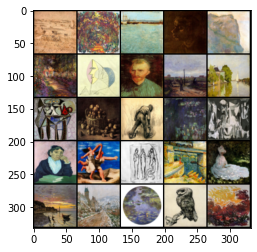

--fake images ---


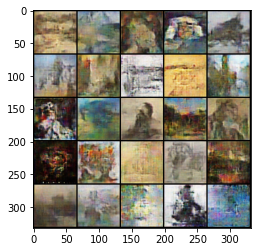

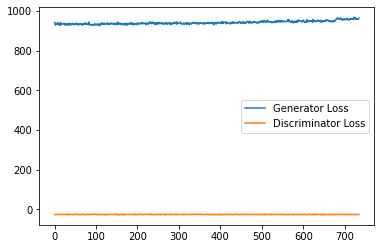

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-14700-epoch-0939.jpg
Epoch [940/990] | Step 14850 | Batch 50/148                   Loss G: 959.8405, loss D: -26.2386, FID: 298.9561
--real images ---


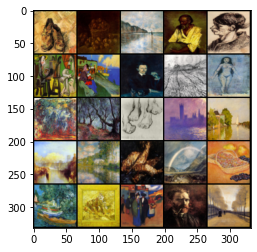

--fake images ---


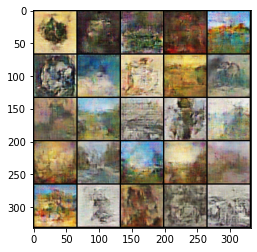

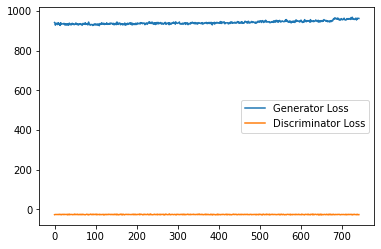

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-14850-epoch-0940.jpg
Saving Wcgan-byartist-v2-generated-images-00148-epoch-0940.jpg


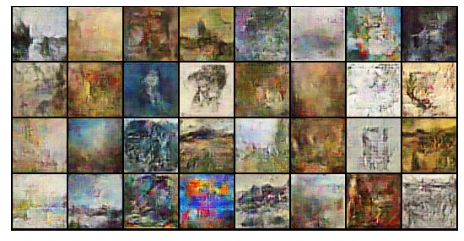

------------------------------------------------------------------------------------
Epoch [941/990] | Step 15000 | Batch 52/148                   Loss G: 958.0681, loss D: -26.3255, FID: 261.2204
--real images ---


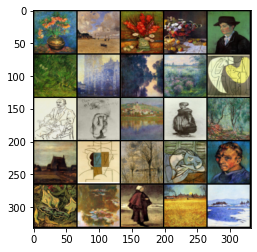

--fake images ---


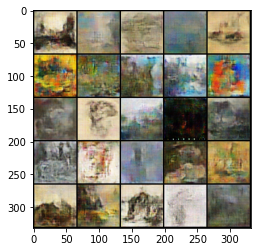

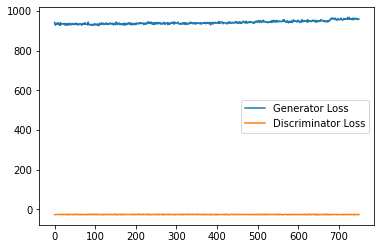

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-15000-epoch-0941.jpg
Epoch [942/990] | Step 15150 | Batch 54/148                   Loss G: 957.9490, loss D: -26.3655, FID: 265.0035
--real images ---


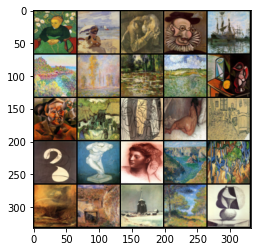

--fake images ---


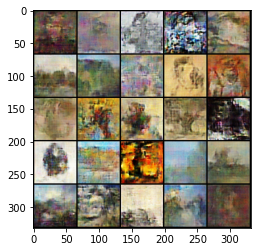

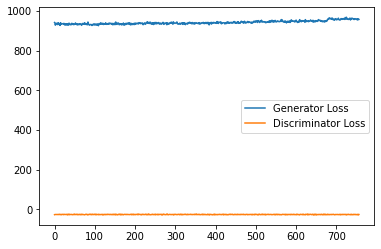

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-15150-epoch-0942.jpg
Epoch [943/990] | Step 15300 | Batch 56/148                   Loss G: 959.5063, loss D: -26.2418, FID: 270.1519
--real images ---


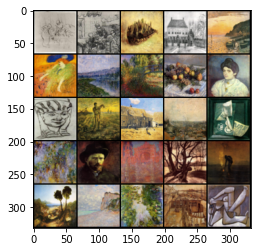

--fake images ---


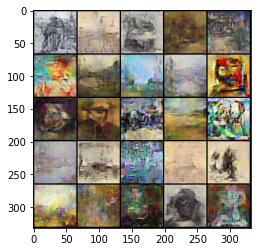

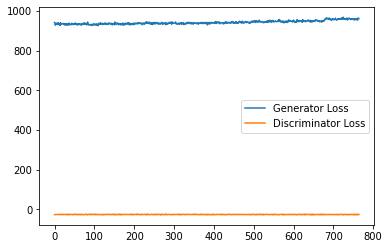

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-15300-epoch-0943.jpg
Epoch [944/990] | Step 15450 | Batch 58/148                   Loss G: 958.9374, loss D: -25.9598, FID: 272.2347
--real images ---


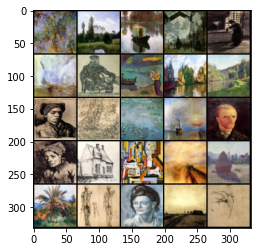

--fake images ---


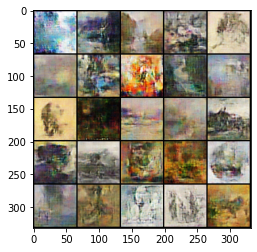

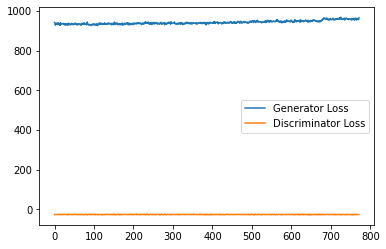

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-15450-epoch-0944.jpg
Epoch [945/990] | Step 15600 | Batch 60/148                   Loss G: 960.1169, loss D: -26.6773, FID: 264.8212
--real images ---


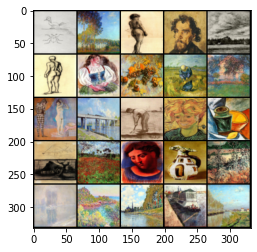

--fake images ---


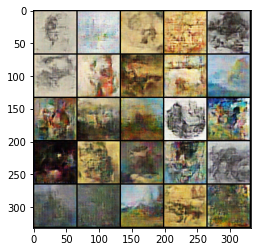

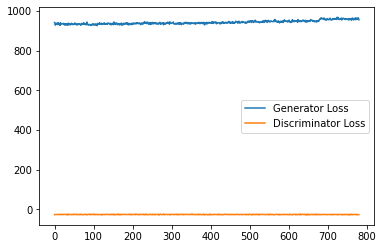

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-15600-epoch-0945.jpg
Epoch [946/990] | Step 15750 | Batch 62/148                   Loss G: 960.1309, loss D: -26.4601, FID: 285.4486
--real images ---


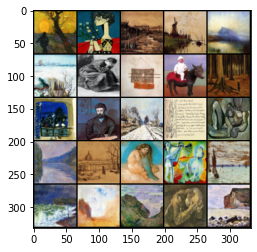

--fake images ---


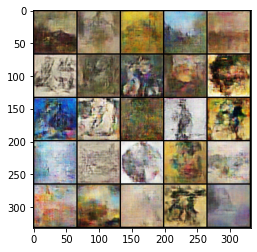

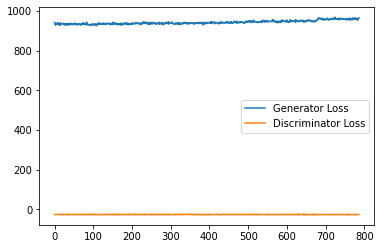

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-15750-epoch-0946.jpg
Epoch [947/990] | Step 15900 | Batch 64/148                   Loss G: 959.3564, loss D: -26.1423, FID: 280.0393
--real images ---


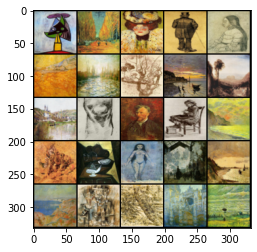

--fake images ---


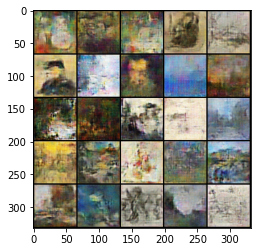

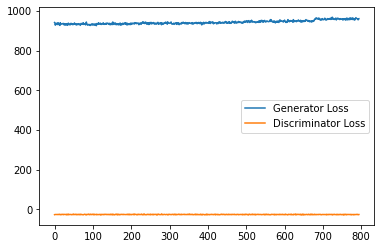

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-15900-epoch-0947.jpg
Epoch [948/990] | Step 16050 | Batch 66/148                   Loss G: 959.4451, loss D: -26.2224, FID: 272.9172
--real images ---


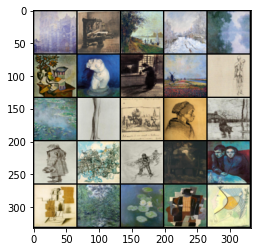

--fake images ---


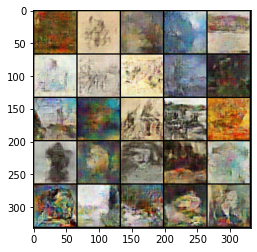

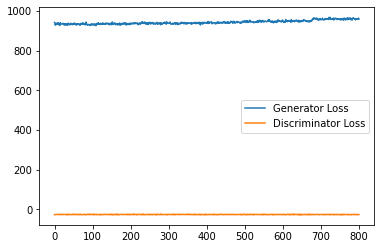

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-16050-epoch-0948.jpg
Epoch [949/990] | Step 16200 | Batch 68/148                   Loss G: 959.7116, loss D: -26.1781, FID: 283.7467
--real images ---


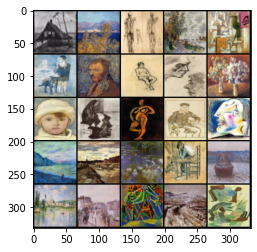

--fake images ---


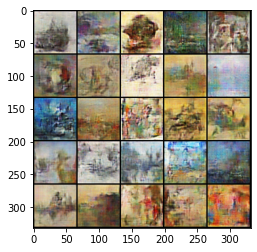

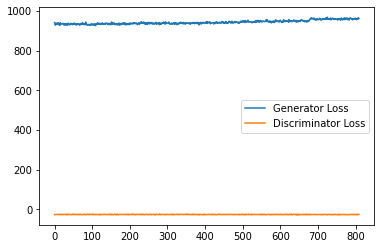

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-16200-epoch-0949.jpg
Epoch [950/990] | Step 16350 | Batch 70/148                   Loss G: 959.2986, loss D: -26.3108, FID: 282.9182
--real images ---


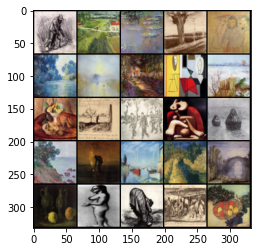

--fake images ---


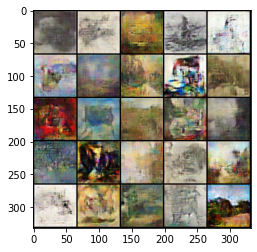

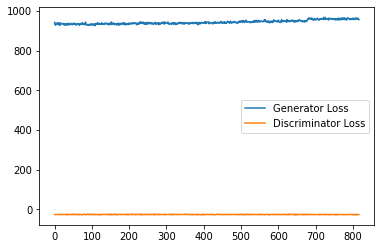

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-16350-epoch-0950.jpg
Epoch [951/990] | Step 16500 | Batch 72/148                   Loss G: 954.1053, loss D: -26.0157, FID: 274.7362
--real images ---


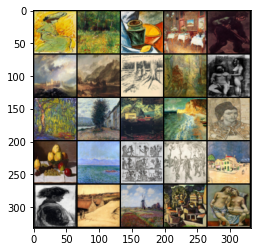

--fake images ---


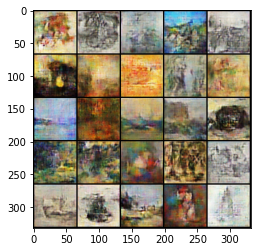

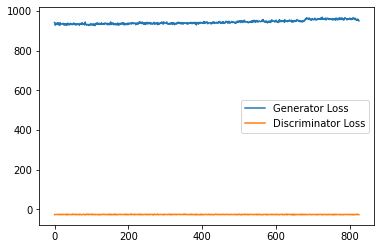

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-16500-epoch-0951.jpg
Epoch [952/990] | Step 16650 | Batch 74/148                   Loss G: 955.3895, loss D: -26.0362, FID: 290.1335
--real images ---


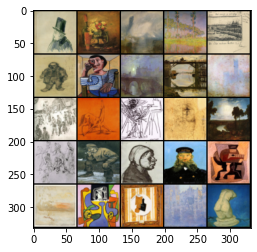

--fake images ---


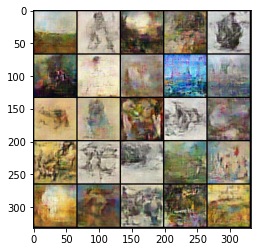

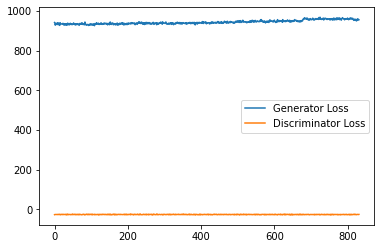

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-16650-epoch-0952.jpg
Epoch [953/990] | Step 16800 | Batch 76/148                   Loss G: 954.5998, loss D: -26.5396, FID: 271.4331
--real images ---


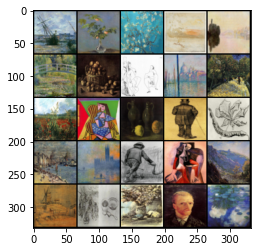

--fake images ---


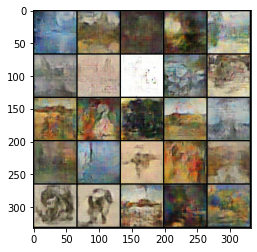

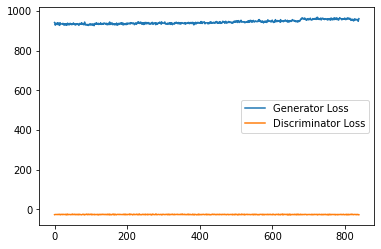

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-16800-epoch-0953.jpg
Epoch [954/990] | Step 16950 | Batch 78/148                   Loss G: 954.4103, loss D: -25.8884, FID: 283.5043
--real images ---


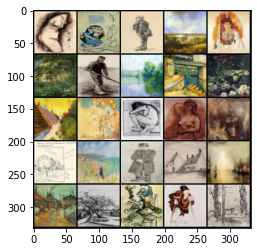

--fake images ---


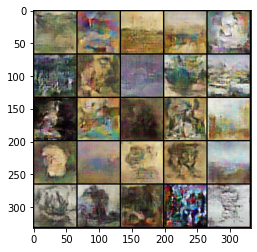

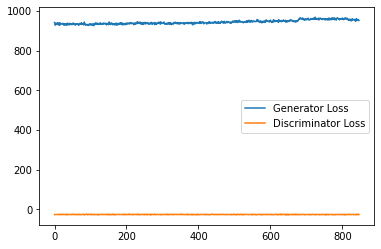

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-16950-epoch-0954.jpg
Epoch [955/990] | Step 17100 | Batch 80/148                   Loss G: 955.3233, loss D: -26.4074, FID: 294.2858
--real images ---


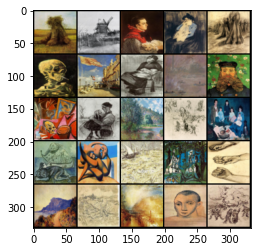

--fake images ---


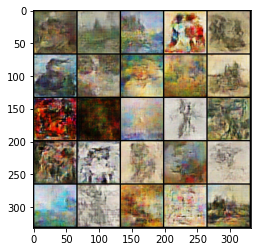

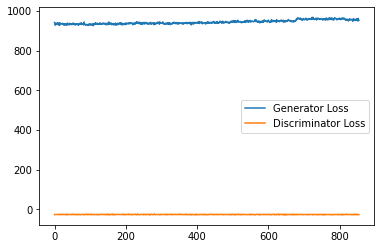

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-17100-epoch-0955.jpg
Epoch [956/990] | Step 17250 | Batch 82/148                   Loss G: 954.5791, loss D: -26.1139, FID: 271.8064
--real images ---


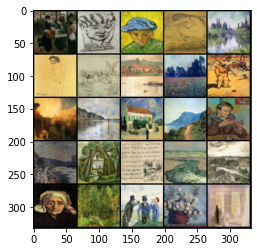

--fake images ---


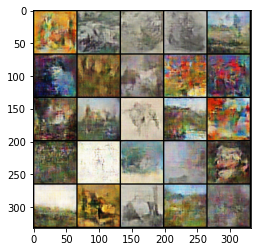

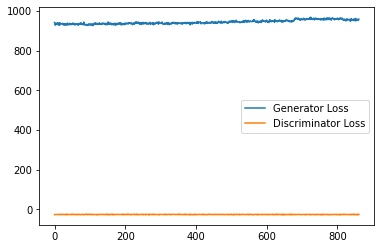

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-17250-epoch-0956.jpg
Epoch [957/990] | Step 17400 | Batch 84/148                   Loss G: 953.9473, loss D: -26.6823, FID: 273.7891
--real images ---


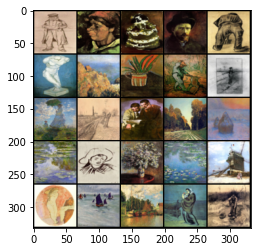

--fake images ---


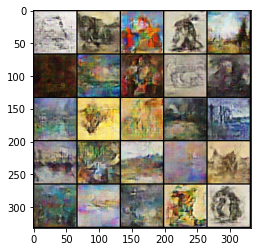

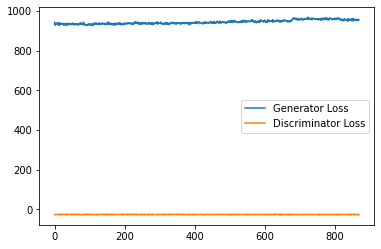

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-17400-epoch-0957.jpg
Epoch [958/990] | Step 17550 | Batch 86/148                   Loss G: 953.2056, loss D: -25.9220, FID: 290.5288
--real images ---


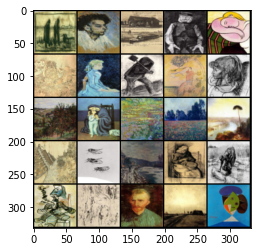

--fake images ---


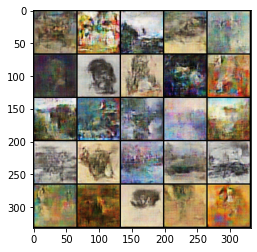

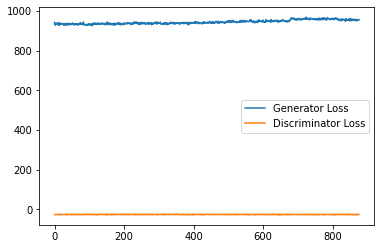

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-17550-epoch-0958.jpg
Epoch [959/990] | Step 17700 | Batch 88/148                   Loss G: 955.7716, loss D: -26.3608, FID: 292.2718
--real images ---


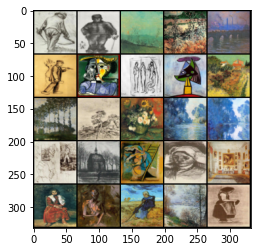

--fake images ---


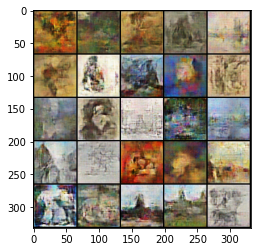

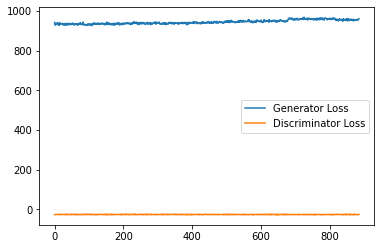

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-17700-epoch-0959.jpg
Epoch [960/990] | Step 17850 | Batch 90/148                   Loss G: 956.5401, loss D: -26.1326, FID: 300.9322
--real images ---


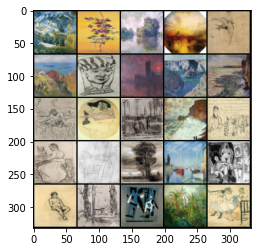

--fake images ---


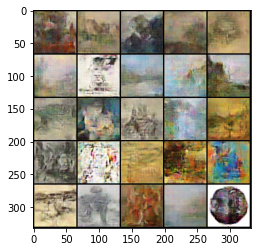

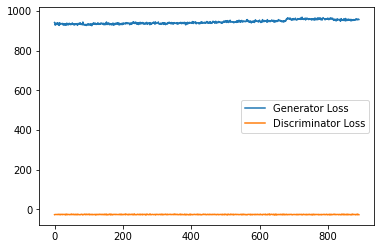

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-17850-epoch-0960.jpg
Saving Wcgan-byartist-v2-generated-images-00148-epoch-0960.jpg


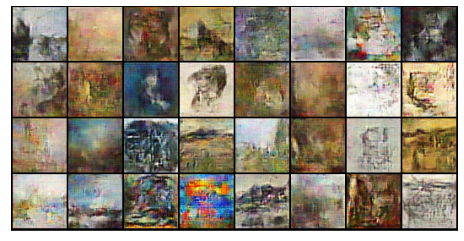

------------------------------------------------------------------------------------
Epoch [961/990] | Step 18000 | Batch 92/148                   Loss G: 953.7976, loss D: -26.6200, FID: 306.9288
--real images ---


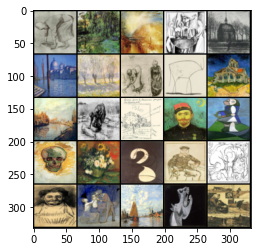

--fake images ---


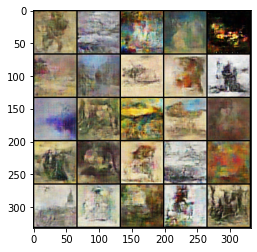

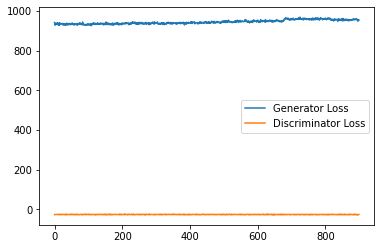

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-18000-epoch-0961.jpg
Epoch [962/990] | Step 18150 | Batch 94/148                   Loss G: 953.1536, loss D: -26.1091, FID: 280.6366
--real images ---


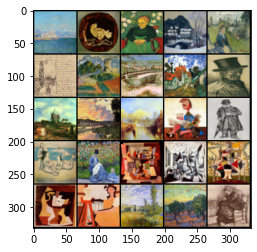

--fake images ---


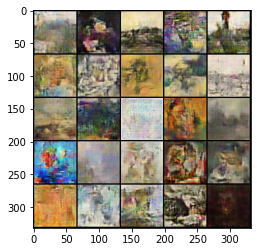

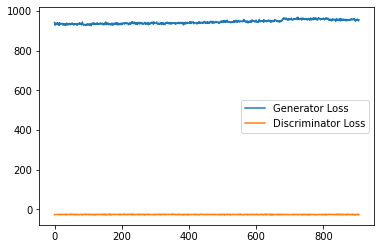

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-18150-epoch-0962.jpg
Epoch [963/990] | Step 18300 | Batch 96/148                   Loss G: 956.5012, loss D: -26.4066, FID: 287.1376
--real images ---


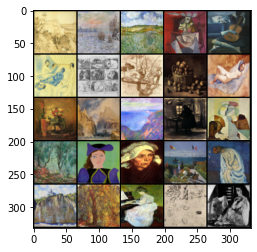

--fake images ---


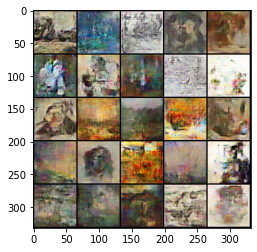

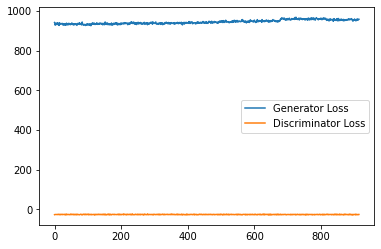

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-18300-epoch-0963.jpg
Epoch [964/990] | Step 18450 | Batch 98/148                   Loss G: 956.5968, loss D: -26.0892, FID: 281.3217
--real images ---


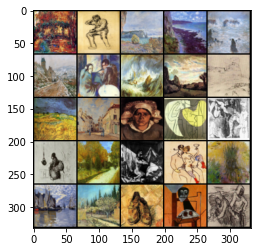

--fake images ---


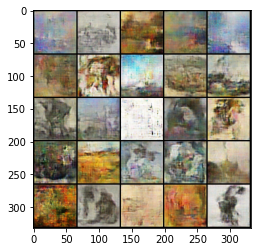

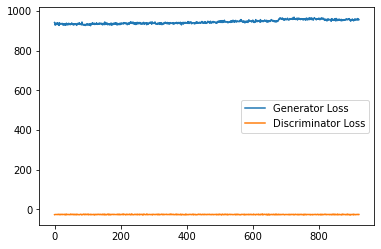

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-18450-epoch-0964.jpg
Epoch [965/990] | Step 18600 | Batch 100/148                   Loss G: 954.5867, loss D: -26.4114, FID: 287.3233
--real images ---


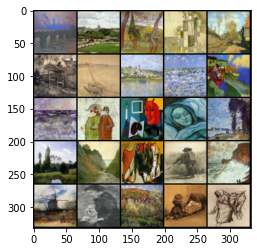

--fake images ---


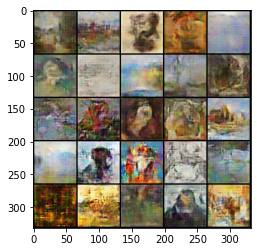

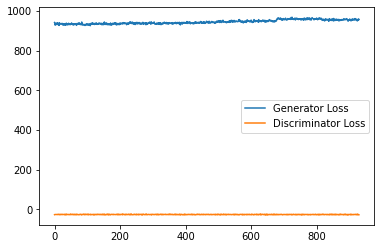

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-18600-epoch-0965.jpg
Epoch [966/990] | Step 18750 | Batch 102/148                   Loss G: 956.3170, loss D: -26.7097, FID: 289.1264
--real images ---


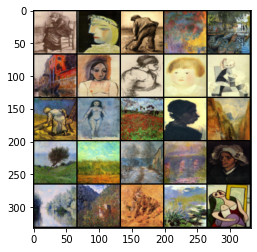

--fake images ---


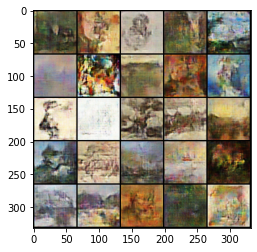

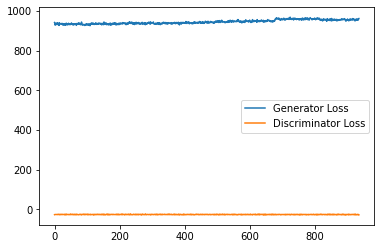

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-18750-epoch-0966.jpg
Epoch [967/990] | Step 18900 | Batch 104/148                   Loss G: 957.6798, loss D: -26.0167, FID: 297.9251
--real images ---


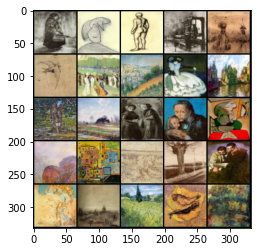

--fake images ---


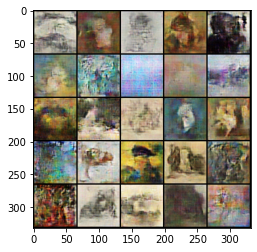

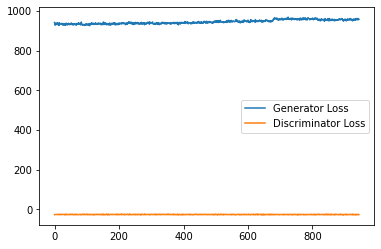

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-18900-epoch-0967.jpg
Epoch [968/990] | Step 19050 | Batch 106/148                   Loss G: 956.1346, loss D: -26.0942, FID: 292.0587
--real images ---


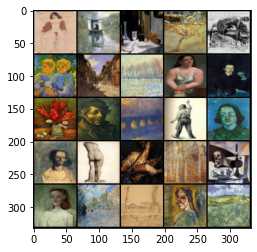

--fake images ---


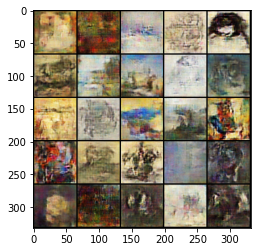

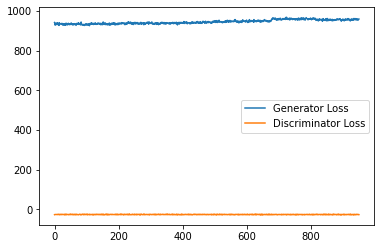

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-19050-epoch-0968.jpg
Epoch [969/990] | Step 19200 | Batch 108/148                   Loss G: 956.7168, loss D: -26.1199, FID: 272.8671
--real images ---


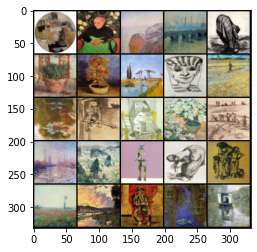

--fake images ---


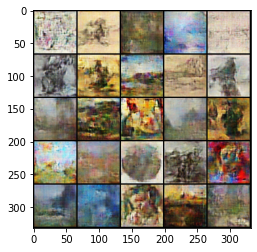

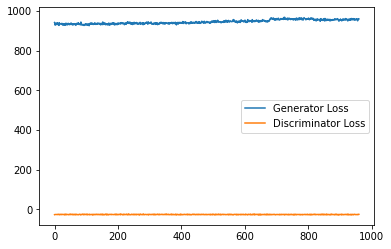

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-19200-epoch-0969.jpg
Epoch [970/990] | Step 19350 | Batch 110/148                   Loss G: 958.5067, loss D: -26.3814, FID: 286.4472
--real images ---


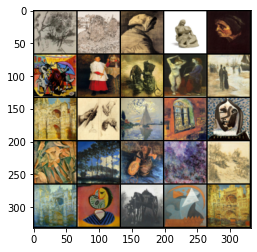

--fake images ---


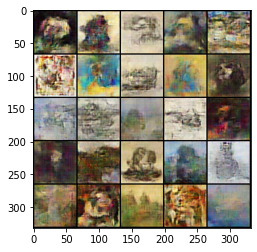

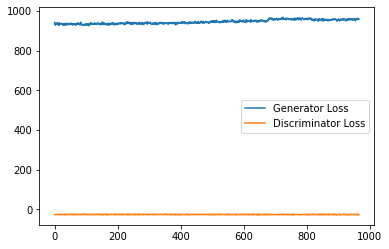

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-19350-epoch-0970.jpg
Epoch [971/990] | Step 19500 | Batch 112/148                   Loss G: 956.2017, loss D: -26.0535, FID: 263.5241
--real images ---


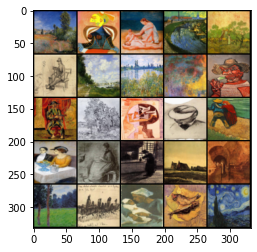

--fake images ---


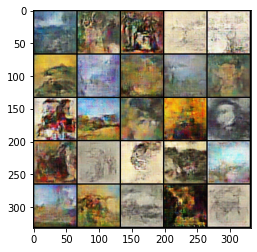

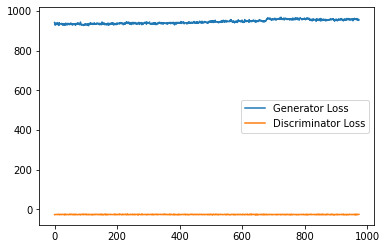

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-19500-epoch-0971.jpg
Epoch [972/990] | Step 19650 | Batch 114/148                   Loss G: 957.2083, loss D: -26.4475, FID: 272.6994
--real images ---


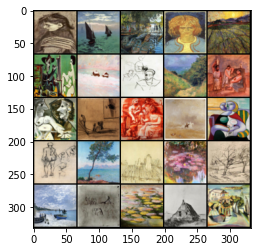

--fake images ---


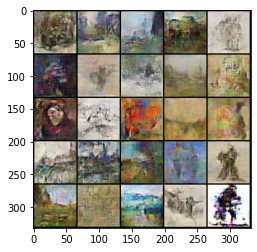

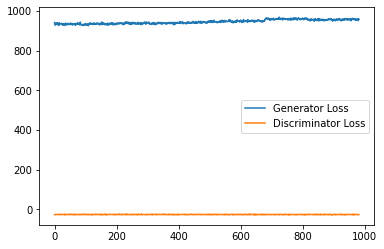

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-19650-epoch-0972.jpg
Epoch [973/990] | Step 19800 | Batch 116/148                   Loss G: 954.9800, loss D: -26.2267, FID: 291.2824
--real images ---


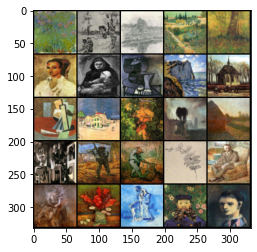

--fake images ---


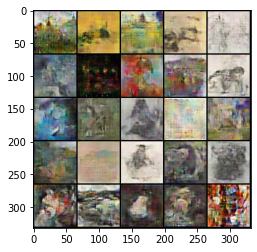

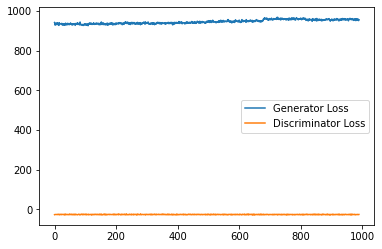

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-19800-epoch-0973.jpg
Epoch [974/990] | Step 19950 | Batch 118/148                   Loss G: 957.0710, loss D: -26.5752, FID: 253.0670
--real images ---


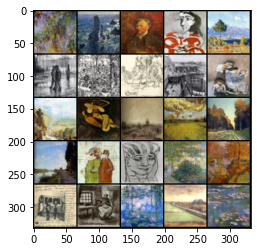

--fake images ---


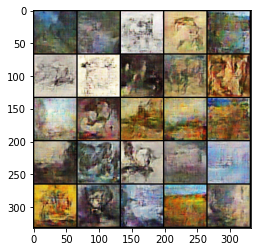

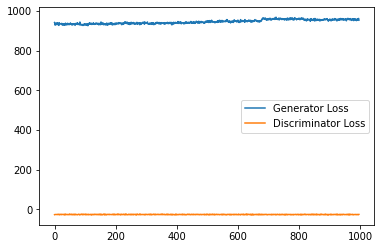

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-19950-epoch-0974.jpg
Epoch [975/990] | Step 20100 | Batch 120/148                   Loss G: 956.5802, loss D: -25.9211, FID: 285.8067
--real images ---


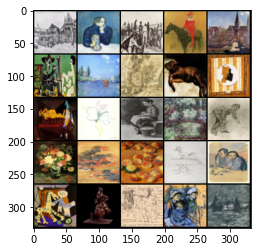

--fake images ---


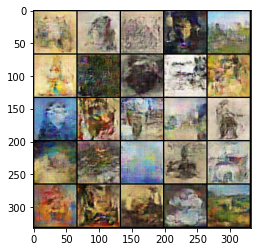

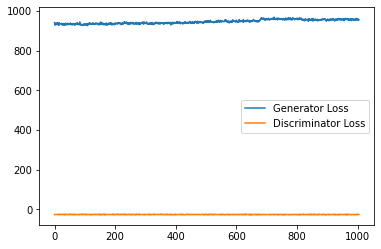

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-20100-epoch-0975.jpg
Epoch [976/990] | Step 20250 | Batch 122/148                   Loss G: 955.6827, loss D: -26.1281, FID: 284.2551
--real images ---


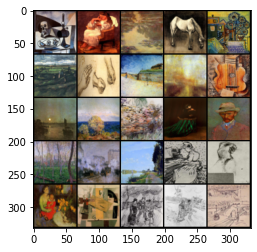

--fake images ---


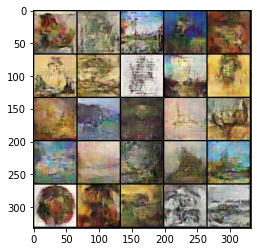

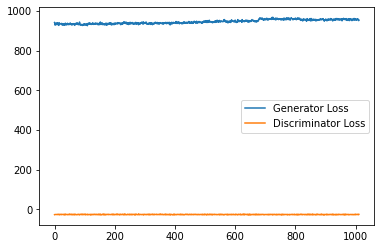

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-20250-epoch-0976.jpg
Epoch [977/990] | Step 20400 | Batch 124/148                   Loss G: 956.7449, loss D: -26.3046, FID: 274.1725
--real images ---


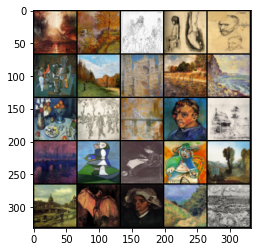

--fake images ---


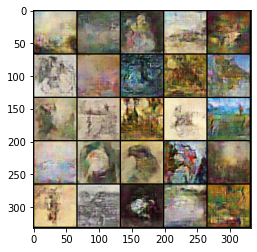

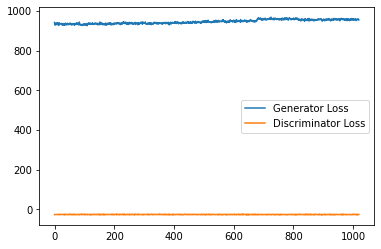

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-20400-epoch-0977.jpg
Epoch [978/990] | Step 20550 | Batch 126/148                   Loss G: 956.9293, loss D: -26.2871, FID: 303.8276
--real images ---


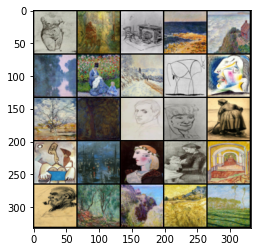

--fake images ---


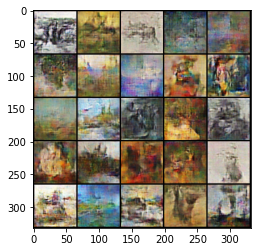

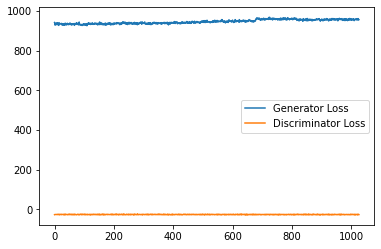

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-20550-epoch-0978.jpg
Epoch [979/990] | Step 20700 | Batch 128/148                   Loss G: 952.5025, loss D: -26.0863, FID: 293.2554
--real images ---


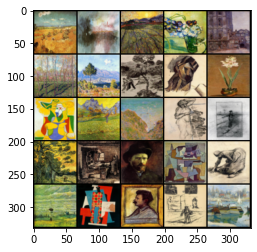

--fake images ---


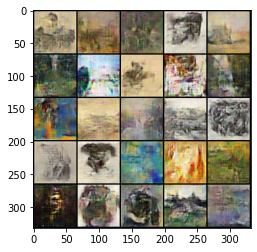

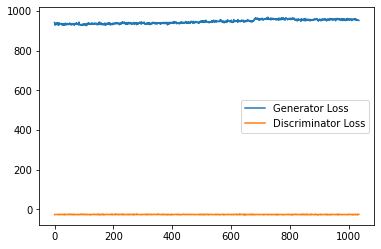

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-20700-epoch-0979.jpg
Epoch [980/990] | Step 20850 | Batch 130/148                   Loss G: 954.4086, loss D: -26.3867, FID: 274.2895
--real images ---


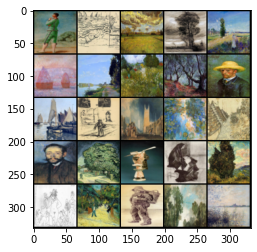

--fake images ---


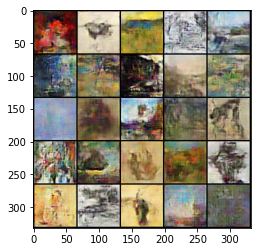

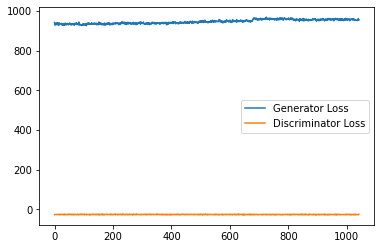

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-20850-epoch-0980.jpg
Saving Wcgan-byartist-v2-generated-images-00148-epoch-0980.jpg


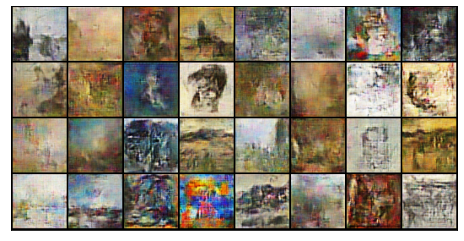

------------------------------------------------------------------------------------
Epoch [981/990] | Step 21000 | Batch 132/148                   Loss G: 956.0536, loss D: -26.3071, FID: 275.5692
--real images ---


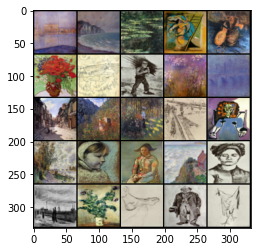

--fake images ---


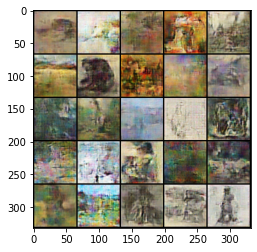

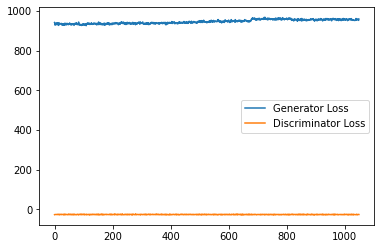

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-21000-epoch-0981.jpg
Epoch [982/990] | Step 21150 | Batch 134/148                   Loss G: 956.2593, loss D: -26.3185, FID: 265.7329
--real images ---


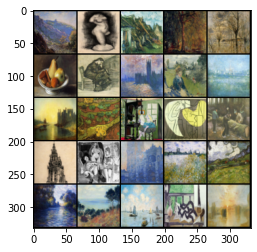

--fake images ---


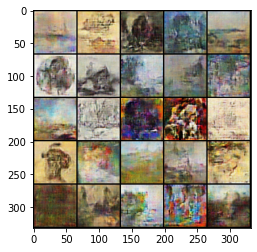

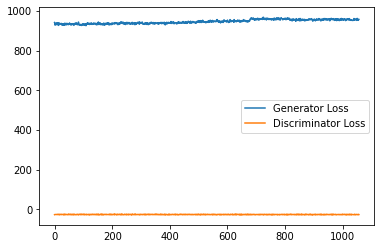

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-21150-epoch-0982.jpg
Epoch [983/990] | Step 21300 | Batch 136/148                   Loss G: 957.7588, loss D: -26.7283, FID: 266.9532
--real images ---


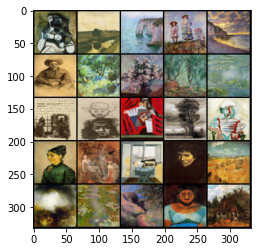

--fake images ---


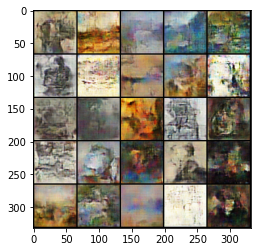

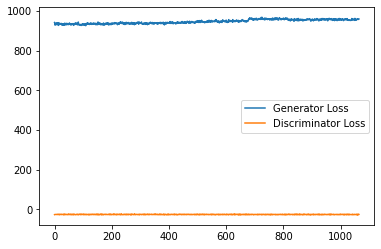

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-21300-epoch-0983.jpg
Epoch [984/990] | Step 21450 | Batch 138/148                   Loss G: 958.1590, loss D: -26.3375, FID: 283.2547
--real images ---


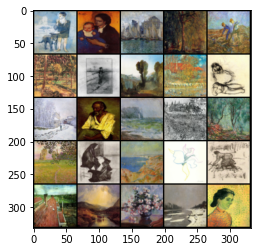

--fake images ---


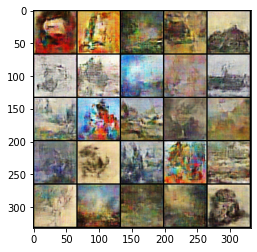

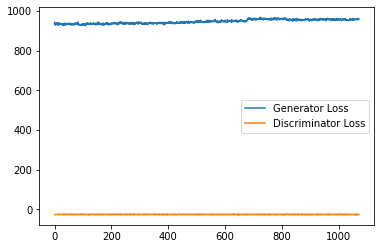

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-21450-epoch-0984.jpg
Epoch [985/990] | Step 21600 | Batch 140/148                   Loss G: 959.0313, loss D: -26.4231, FID: 265.2344
--real images ---


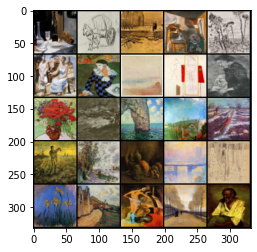

--fake images ---


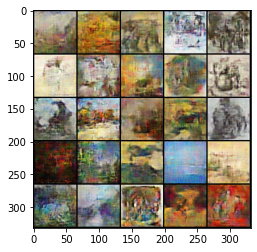

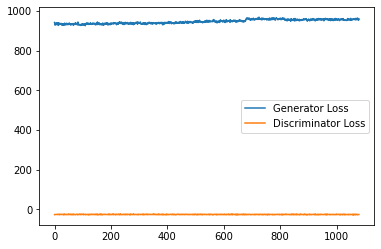

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-21600-epoch-0985.jpg
Epoch [986/990] | Step 21750 | Batch 142/148                   Loss G: 958.8197, loss D: -26.5116, FID: 310.5134
--real images ---


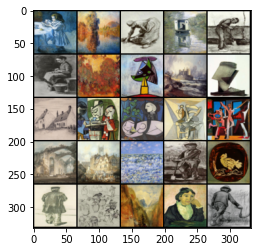

--fake images ---


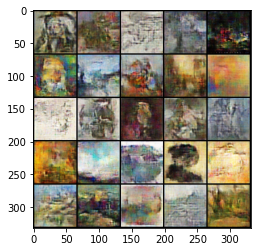

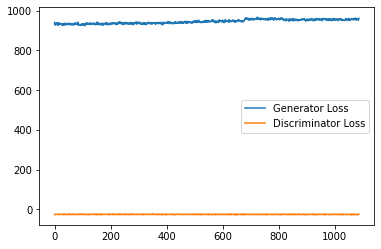

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-21750-epoch-0986.jpg
Epoch [987/990] | Step 21900 | Batch 144/148                   Loss G: 959.3826, loss D: -26.1964, FID: 281.5487
--real images ---


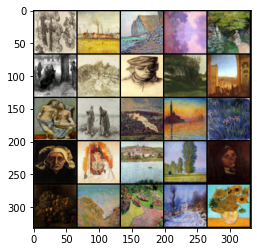

--fake images ---


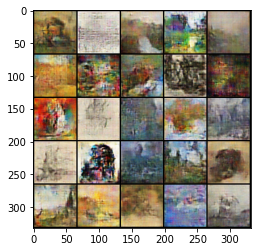

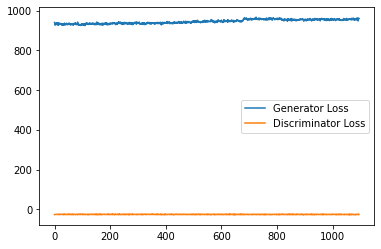

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-21900-epoch-0987.jpg
Epoch [988/990] | Step 22050 | Batch 146/148                   Loss G: 959.9430, loss D: -26.1809, FID: 251.3578
--real images ---


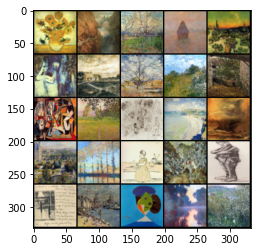

--fake images ---


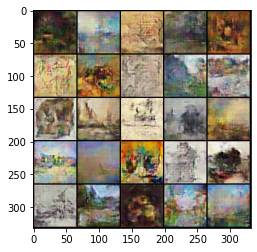

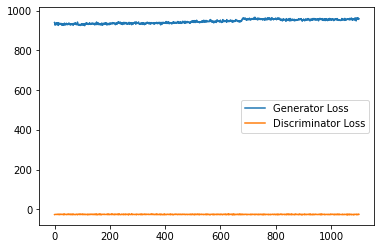

saving images generated with fixed noise
Saving Wcgan-byartist-v2-generated-images-22050-epoch-0988.jpg


In [ ]:
# # --- Mnist 
# dataset = datasets.MNIST(root="dataset/", transform=transformations, download=True)
# loader = DataLoader(
#     dataset,
#     batch_size=BATCH_SIZE,
#     shuffle=True,
# )

# initialize gen and disc, note: discriminator should be called critic,
# according to WGAN paper (since it no longer outputs between [0, 1])
gen = Generator(Z_DIM, CHANNELS_IMG, FEATURES_GEN, NUM_CLASSES, IMG_SIZE, GENERATOR_EMBEDDING).to(device)
critic = Discriminator(CHANNELS_IMG, FEATURES_CRITIC, NUM_CLASSES,IMG_SIZE).to(device)

# initializate optimizer
opt_gen = optim.Adam(gen.parameters(), lr=LEARNING_RATE, betas=(0.0, 0.9))
opt_critic = optim.Adam(critic.parameters(), lr=LEARNING_RATE, betas=(0.0, 0.9))

ckpt_path  = f'/mydrive/GAN/Models/by_artist_2/2021_09_28_WcGAN_BYARTIST_v2_{NUM_EPOCHS_START}_latest.pkl'
#ckpt_path =  None
if ckpt_path is not None:
    ckpt = torch.load(ckpt_path)
    gen.load_state_dict(ckpt['gen_state_dict'])
    critic.load_state_dict(ckpt['disc_state_dict'])
    opt_gen.load_state_dict(ckpt['gen_optimizer_state_dict'])
    opt_critic.load_state_dict(ckpt['disc_optimizer_state_dict'])
else: 
    initialize_weights(gen)
    initialize_weights(critic)


# for tensorboard plotting
fixed_noise = torch.randn(BATCH_SIZE , Z_DIM, 1, 1).to(device)
fixed_labels  = torch.tensor(list(np.arange(0,NUM_CLASSES))*10)[:BATCH_SIZE].to(device)
#fixed_labels  = torch.tensor(list(np.arange(0,NUM_CLASSES))*6+[0,0,0,0]).to(device) # to have dim 64 

writer  =  SummaryWriter(log_dir)
writer_real = SummaryWriter(os.path.join(log_dir,'real'))
writer_fake = SummaryWriter(os.path.join(log_dir,'fake'))

gen.train()
critic.train()

generator_losses = []
critic_losses =[]

step = 0

for epoch in range(NUM_EPOCHS_START, NUM_EPOCHS):
    for batch_idx, (real, labels, path) in enumerate(loader):
        real = real.to(device)
        cur_batch_size = real.shape[0]
        labels = labels.to(device)
        mean_iteration_critic_loss =0
        mean_iteration_generator_loss=0

        # Train Critic: max E[critic(real)] - E[critic(fake)]
        # equivalent to minimizing the negative of that
        for _ in range(CRITIC_ITERATIONS):
            noise = torch.randn(cur_batch_size, Z_DIM, 1, 1).to(device)
            fake = gen(noise, labels)
            critic_real = critic(real, labels).reshape(-1)
            critic_fake = critic(fake, labels).reshape(-1)
            gp = gradient_penalty(critic,labels, real, fake, device=device)
            loss_critic = (
                -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            )
            critic.zero_grad()
            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += loss_critic.item() / CRITIC_ITERATIONS
            loss_critic.backward(retain_graph=True)
            opt_critic.step()

        critic_losses += [mean_iteration_critic_loss]

        # Train Generator: max E[critic(gen_fake)] <-> min -E[critic(gen_fake)]
        for _ in range(GENERATOR_ITERATIONS):
            gen_fake = critic(fake, labels).reshape(-1)
            loss_gen = -torch.mean(gen_fake)
            gen.zero_grad()
            # Keep track of the average critic loss in this batch
            mean_iteration_generator_loss += loss_gen.item() / GENERATOR_ITERATIONS
            loss_gen.backward()
            opt_gen.step()

        generator_losses += [mean_iteration_generator_loss]

        
        # Print losses occasionally and print to tensorboard
        if step % NUM_DISPLAY == 0 and step > 0:
            gen_mean_loss = sum(generator_losses[-NUM_DISPLAY:]) / NUM_DISPLAY 
            crit_mean_loss = sum(critic_losses[-NUM_DISPLAY:]) / NUM_DISPLAY 
            
            # FID 
            fretchet_dist=calculate_fretchet(real,fake,model)

            print(
                f"Epoch [{epoch}/{NUM_EPOCHS}] | Step {step} | Batch {batch_idx}/{len(loader)} \
                  Loss G: {gen_mean_loss:.4f}, loss D: {crit_mean_loss:.4f}, FID: {fretchet_dist:.4f}"
            )

            with torch.no_grad():
                # print('fixed_noise shape :', fixed_noise.shape)
                # print('fixed_labels shape :', fixed_labels.shape)
                #fake = gen(fixed_noise, fixed_labels)
                fake = gen(noise, labels)
                # take out (up to) 32 examples
                img_grid_real = torchvision.utils.make_grid(real[:32], normalize=True)
                img_grid_fake = torchvision.utils.make_grid(fake[:32], normalize=True)

                # -- writer
                writer_real.add_image("Real", img_grid_real, global_step=step)
                writer_fake.add_image("Fake", img_grid_fake, global_step=step)

                # -- write to writer
                writer.add_scalar("loss_gen", gen_mean_loss, step)
                writer.add_scalar("loss_critic", crit_mean_loss, step)

                print('--real images ---')
                show_tensor_images(real)
                print('--fake images ---')
                show_tensor_images(fake)

                step_bins = 20
                num_examples = (len(generator_losses) // step_bins) * step_bins
                plt.plot(
                    range(num_examples // step_bins), 
                    torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                    label="Generator Loss"
                )
                plt.plot(
                    range(num_examples // step_bins), 
                    torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                    label="Discriminator Loss"
                )
                plt.legend()
                plt.show()

                print('saving images generated with fixed noise')
                save_samples(step, epoch, fixed_noise, fixed_labels, stats, sample_dir = sample_dir, resize_size=128, show=False)    
       
        step += 1
    # -- save the model at the end of the epoch 
    if epoch % SAVE_EPOCH == 0 and epoch > 0:
        torch.save({
        'gen_state_dict': gen.state_dict(),
        'disc_state_dict': critic.state_dict(),
        'gen_optimizer_state_dict': opt_gen.state_dict(),
        'disc_optimizer_state_dict': opt_critic.state_dict(),
        }, os.path.join(model_save_DIR, f'{date}_WcGAN_BYARTIST_v2_{epoch}_latest.pkl'))

        save_samples(len(loader), epoch,fixed_noise,fixed_labels, stats,sample_dir = sample_dir, resize_size=128, show=True)  

        print('------------------------------------------------------------------------------------')





In [ ]:
writer.flush()
writer_real.flush()
writer_fake.flush()
writer_real.close()
writer_fake.close()
writer.close()

In [ ]:
log_dir

'/mydrive/GAN/logs/Wcgan/by_artist_2'

## tensorboard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir=/mydrive/GAN/logs/Wcgan/by_artist_2

<IPython.core.display.Javascript object>

In [ ]:
!ls /mydrive/GAN/logs/Wcgan/by_artist_2


events.out.tfevents.1630675208.c728a9a99077.76.0
events.out.tfevents.1630678725.c728a9a99077.76.3
events.out.tfevents.1630689705.302a0382f005.122.0
events.out.tfevents.1631481423.6149b9c1af09.75.0
events.out.tfevents.1631605573.e5d19baf54f3.74.0
events.out.tfevents.1631692767.9249ee7be964.75.0
events.out.tfevents.1631784842.5a60b482854b.73.0
events.out.tfevents.1631817529.0b790a695360.78.0
events.out.tfevents.1632061533.304bb5433688.77.0
events.out.tfevents.1632075761.129383f334cf.77.0
events.out.tfevents.1632077971.129383f334cf.77.3
events.out.tfevents.1632078670.129383f334cf.77.6
events.out.tfevents.1632084835.2bc5ab63a753.77.0
events.out.tfevents.1632126514.757b91b2c8e4.76.0
events.out.tfevents.1632128237.757b91b2c8e4.76.3
events.out.tfevents.1632151413.757b91b2c8e4.76.6
events.out.tfevents.1632747155.6d4f77680177.78.0
events.out.tfevents.1632830639.e189315e0191.76.0
events.out.tfevents.1632994662.15815a4477d4.77.0
fake
real


In [ ]:
%reload_ext tensorboard

In [ ]:
rferf

NameError: ignored

## OLD TRAIN

In [ ]:

# Hyperparameters etc.
device = "cuda" if torch.cuda.is_available() else "cpu"
LEARNING_RATE = 1e-4
BATCH_SIZE = 64
IMAGE_SIZE = 64
CHANNELS_IMG = 1
Z_DIM = 124
NUM_EPOCHS = 2
FEATURES_CRITIC = 64
FEATURES_GEN = 64
CRITIC_ITERATIONS = 5
LAMBDA_GP = 10
IMG_SIZE= 64
NUM_CLASSES = 10
GENERATOR_EMBEDDING  = 10

transformations = transforms.Compose(
    [
        transforms.Resize(IMAGE_SIZE),
        transforms.ToTensor(),
        transforms.Normalize(
            [0.5 for _ in range(CHANNELS_IMG)], [0.5 for _ in range(CHANNELS_IMG)]),
    ]
)

dataset = datasets.MNIST(root="dataset/", transform=transformations, download=True)
loader = DataLoader(
    dataset,
    batch_size=BATCH_SIZE,
    shuffle=True,
)

# initialize gen and disc, note: discriminator should be called critic,
# according to WGAN paper (since it no longer outputs between [0, 1])
gen = Generator(Z_DIM, CHANNELS_IMG, FEATURES_GEN, NUM_CLASSES, IMG_SIZE, GENERATOR_EMBEDDING).to(device)
critic = Discriminator(CHANNELS_IMG, FEATURES_CRITIC, NUM_CLASSES,IMG_SIZE).to(device)
initialize_weights(gen)
initialize_weights(critic)

# initializate optimizer
opt_gen = optim.Adam(gen.parameters(), lr=LEARNING_RATE, betas=(0.0, 0.9))
opt_critic = optim.Adam(critic.parameters(), lr=LEARNING_RATE, betas=(0.0, 0.9))

# for tensorboard plotting
fixed_noise = torch.randn(BATCH_SIZE , Z_DIM, 1, 1).to(device)
fixed_labels  = torch.tensor(list(np.arange(0,NUM_CLASSES))*6+[0,0,0,0]).to(device) # to have dim 64 
writer_real = SummaryWriter(f"logs/GAN_MNIST/real")
writer_fake = SummaryWriter(f"logs/GAN_MNIST/fake")
step = 0
# -- save DIR   
DIR = '/mydrive/GAN' 
sample_dir = os.path.join(DIR,'generated','Wcgan','art_2')
os.makedirs(sample_dir, exist_ok=True)
model_save_DIR = os.path.join(DIR,'Models','art_2')


gen.train()
critic.train()

generator_losses = []
critic_losses =[]
for epoch in range(NUM_EPOCHS):
    # Target labels not needed! <3 unsupervised
    for batch_idx, (real, labels) in enumerate(loader):
        real = real.to(device)
        cur_batch_size = real.shape[0]
        labels = labels.to(device)
        # Train Critic: max E[critic(real)] - E[critic(fake)]
        # equivalent to minimizing the negative of that
        for _ in range(CRITIC_ITERATIONS):
            noise = torch.randn(cur_batch_size, Z_DIM, 1, 1).to(device)
            fake = gen(noise, labels)
            critic_real = critic(real, labels).reshape(-1)
            critic_fake = critic(fake, labels).reshape(-1)
            gp = gradient_penalty(critic,labels,  real, fake, device=device)
            loss_critic = (
                -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            )
            critic.zero_grad()
            loss_critic.backward(retain_graph=True)
            opt_critic.step()
            critic_losses += [loss_critic.item()]

        # Train Generator: max E[critic(gen_fake)] <-> min -E[critic(gen_fake)]
        gen_fake = critic(fake, labels).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        gen.zero_grad()
        loss_gen.backward()
        opt_gen.step()

        
        generator_losses += [loss_gen.item()]
        

        # Print losses occasionally and print to tensorboard
        if batch_idx % 100 == 0 and batch_idx > 0:
            print(
                f"Epoch [{epoch}/{NUM_EPOCHS}] Batch {batch_idx}/{len(loader)} \
                  Loss D: {loss_critic:.4f}, loss G: {loss_gen:.4f}"
            )

            with torch.no_grad():
                # print('fixed_noise shape :', fixed_noise.shape)
                # print('fixed_labels shape :', fixed_labels.shape)
                fake = gen(fixed_noise, fixed_labels)
                # take out (up to) 32 examples
                img_grid_real = torchvision.utils.make_grid(real[:32], normalize=True)
                img_grid_fake = torchvision.utils.make_grid(fake[:32], normalize=True)

                writer_real.add_image("Real", img_grid_real, global_step=step)
                writer_fake.add_image("Fake", img_grid_fake, global_step=step)

                print('--real images ---')
                show_tensor_images(real)
                print('--fake images ---')
                show_tensor_images(fake)

                step_bins = 20
                num_examples = (len(generator_losses) // step_bins) * step_bins
                plt.plot(
                    range(num_examples // step_bins), 
                    torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                    label="Generator Loss"
                )
                plt.plot(
                    range(num_examples // step_bins), 
                    torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                    label="Discriminator Loss"
                )
                plt.legend()
                plt.show()
                print('saving images generated with fixed noise')
                save_samples(step, epoch, fixed_noise, fixed_labels,sample_dir = sample_dir, resize_size=128, show=False)  

            step += 1